## Problem Statement

ReneWind is focused on using machine learning to predict wind turbine generator failures in order to reduce maintenance and replacement costs. They have collected sensor data, provided in a ciphered form for confidentiality, consisting of 40 predictor variables with 20,000 training and 5,000 test observations. The target variable indicates 1 for failure and 0 for no failure. Correctly predicting a failure (true positive) incurs a repair cost, missing a failure (false negative) leads to a high replacement cost, and false alarms (false positives) result in a lower inspection cost. The primary goal is to build and tune classification models that can accurately detect potential failures, minimizing costly replacements while keeping repair and inspection costs under control.

## Data Dictionary

The data provided is a transformed version of the original data which was collected using sensors.

Train.csv - For training and tuning of models.
Test.csv - For testing the performance of the final best model.
Both datasets consist of 40 predictor variables and 1 target variable.

## Importing the Necessary Libraries

In [1]:
# Library for data manipulation and analysis.
import pandas as pd
# Fundamental package for scientific computing.
import numpy as np
#splitting datasets into training and testing sets.
from sklearn.model_selection import train_test_split
#Imports tools for data preprocessing including label encoding, one-hot encoding, and standard scaling
from sklearn.preprocessing import LabelEncoder, OneHotEncoder,StandardScaler
#Imports a class for imputing missing values in datasets.
from sklearn.impute import SimpleImputer
#Imports the Matplotlib library for creating visualizations.
import matplotlib.pyplot as plt
# Imports the Seaborn library for statistical data visualization.
import seaborn as sns
# Time related functions.
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import BatchNormalization
from tensorflow import keras
import tensorflow as tf
from tensorflow.keras.layers import Dropout
#Imports functions for evaluating the performance of machine learning models
from sklearn.metrics import confusion_matrix, f1_score,accuracy_score, recall_score, precision_score, classification_report
import warnings

# Suppress all warnings
warnings.filterwarnings('ignore')


In [2]:
# Set the seed using keras.utils.set_random_seed. This will set:
# 1) `numpy` seed
# 2) backend random seed
# 3) `python` random seed
tf.keras.utils.set_random_seed(812)

## Loading the Dataset

In [3]:
# Mounting Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Loading the training dataset
renedatatrain = pd.read_csv('/content/drive/My Drive/Train.csv')

In [5]:
# copying data to another variable to avoid any changes to original data
train_data = renedatatrain.copy()

In [6]:
# Loading the test dataset
renedatatest = pd.read_csv('/content/drive/My Drive/Test.csv')

In [7]:
# copying data to another variable to avoid any changes to original data
test_data = renedatatest.copy()

## Overview of the Dataset
### Viewing first five, last five and some samples of dataset

In [8]:
# Displaying first five rows of train set
train_data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.464606,-4.679129,3.101546,0.506130,-0.221083,-2.032511,-2.910870,0.050714,-1.522351,3.761892,...,3.059700,-1.690440,2.846296,2.235198,6.667486,0.443809,-2.369169,2.950578,-3.480324,0
1,3.365912,3.653381,0.909671,-1.367528,0.332016,2.358938,0.732600,-4.332135,0.565695,-0.101080,...,-1.795474,3.032780,-2.467514,1.894599,-2.297780,-1.731048,5.908837,-0.386345,0.616242,0
2,-3.831843,-5.824444,0.634031,-2.418815,-1.773827,1.016824,-2.098941,-3.173204,-2.081860,5.392621,...,-0.257101,0.803550,4.086219,2.292138,5.360850,0.351993,2.940021,3.839160,-4.309402,0
3,1.618098,1.888342,7.046143,-1.147285,0.083080,-1.529780,0.207309,-2.493629,0.344926,2.118578,...,-3.584425,-2.577474,1.363769,0.622714,5.550100,-1.526796,0.138853,3.101430,-1.277378,0
4,-0.111440,3.872488,-3.758361,-2.982897,3.792714,0.544960,0.205433,4.848994,-1.854920,-6.220023,...,8.265896,6.629213,-10.068689,1.222987,-3.229763,1.686909,-2.163896,-3.644622,6.510338,0


In [9]:
# Displaying first five rows of test set
test_data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-0.613489,-3.819640,2.202302,1.300420,-1.184929,-4.495964,-1.835817,4.722989,1.206140,-0.341909,...,2.291204,-5.411388,0.870073,0.574479,4.157191,1.428093,-10.511342,0.454664,-1.448363,0
1,0.389608,-0.512341,0.527053,-2.576776,-1.016766,2.235112,-0.441301,-4.405744,-0.332869,1.966794,...,-2.474936,2.493582,0.315165,2.059288,0.683859,-0.485452,5.128350,1.720744,-1.488235,0
2,-0.874861,-0.640632,4.084202,-1.590454,0.525855,-1.957592,-0.695367,1.347309,-1.732348,0.466500,...,-1.318888,-2.997464,0.459664,0.619774,5.631504,1.323512,-1.752154,1.808302,1.675748,0
3,0.238384,1.458607,4.014528,2.534478,1.196987,-3.117330,-0.924035,0.269493,1.322436,0.702345,...,3.517918,-3.074085,-0.284220,0.954576,3.029331,-1.367198,-3.412140,0.906000,-2.450889,0
4,5.828225,2.768260,-1.234530,2.809264,-1.641648,-1.406698,0.568643,0.965043,1.918379,-2.774855,...,1.773841,-1.501573,-2.226702,4.776830,-6.559698,-0.805551,-0.276007,-3.858207,-0.537694,0


There are 40 independent variables in the dataset and a target column called "Target".

In [10]:
# Displaying last five rows of train set
train_data.tail()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
19995,-2.071318,-1.088279,-0.796174,-3.011720,-2.287540,2.807310,0.481428,0.105171,-0.586599,-2.899398,...,-8.273996,5.745013,0.589014,-0.649988,-3.043174,2.216461,0.608723,0.178193,2.927755,1
19996,2.890264,2.483069,5.643919,0.937053,-1.380870,0.412051,-1.593386,-5.762498,2.150096,0.272302,...,-4.159092,1.181466,-0.742412,5.368979,-0.693028,-1.668971,3.659954,0.819863,-1.987265,0
19997,-3.896979,-3.942407,-0.351364,-2.417462,1.107546,-1.527623,-3.519882,2.054792,-0.233996,-0.357687,...,7.112162,1.476080,-3.953710,1.855555,5.029209,2.082588,-6.409304,1.477138,-0.874148,0
19998,-3.187322,-10.051662,5.695955,-4.370053,-5.354758,-1.873044,-3.947210,0.679420,-2.389254,5.456756,...,0.402812,3.163661,3.752095,8.529894,8.450626,0.203958,-7.129918,4.249394,-6.112267,0
19999,-2.686903,1.961187,6.137088,2.600133,2.657241,-4.290882,-2.344267,0.974004,-1.027462,0.497421,...,6.620811,-1.988786,-1.348901,3.951801,5.449706,-0.455411,-2.202056,1.678229,-1.974413,0


In [11]:
# Displaying last five rows of test set
test_data.tail()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
4995,-5.120451,1.634804,1.251259,4.035944,3.291204,-2.932230,-1.328662,1.754066,-2.984586,1.248633,...,9.979118,0.063438,0.217281,3.036388,2.109323,-0.557433,1.938718,0.512674,-2.694194,0
4996,-5.172498,1.171653,1.579105,1.219922,2.529627,-0.668648,-2.618321,-2.000545,0.633791,-0.578938,...,4.423900,2.603811,-2.152170,0.917401,2.156586,0.466963,0.470120,2.196756,-2.376515,0
4997,-1.114136,-0.403576,-1.764875,-5.879475,3.571558,3.710802,-2.482952,-0.307614,-0.921945,-2.999141,...,3.791778,7.481506,-10.061396,-0.387166,1.848509,1.818248,-1.245633,-1.260876,7.474682,0
4998,-1.703241,0.614650,6.220503,-0.104132,0.955916,-3.278706,-1.633855,-0.103936,1.388152,-1.065622,...,-4.100352,-5.949325,0.550372,-1.573640,6.823936,2.139307,-4.036164,3.436051,0.579249,0
4999,-0.603701,0.959550,-0.720995,8.229574,-1.815610,-2.275547,-2.574524,-1.041479,4.129645,-2.731288,...,2.369776,-1.062408,0.790772,4.951955,-7.440825,-0.069506,-0.918083,-2.291154,-5.362891,0


In [12]:
# Displaying twenty random rows of train set
train_data.sample(20)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
12064,-0.764552,-4.941473,0.222119,-5.095314,-1.262965,-1.112442,-2.694133,0.192237,0.986656,-0.559456,...,-2.489202,-4.217574,-1.504447,-0.134008,6.486465,4.214021,-5.031245,2.967805,0.685425,0
1557,-4.089934,3.152208,3.423398,3.999387,2.250355,-2.849602,-0.595100,1.126280,-3.093891,1.350575,...,8.946837,3.060782,0.563135,5.420494,0.689776,-2.158107,2.568949,0.539156,-4.008018,0
547,-0.029813,-3.022956,-0.265373,-4.457207,0.300206,-0.144165,-0.065150,2.777640,-2.104705,0.885664,...,1.382491,-0.363915,-1.435063,-0.912192,4.796112,1.195906,-3.659618,0.664196,2.633353,0
13830,2.898566,-1.006482,-2.702558,-4.060640,-1.094510,0.348894,3.174205,4.285828,-1.695746,-2.051190,...,-7.683395,-5.242774,1.483598,-5.274655,0.553090,3.235861,-1.345798,-0.920241,6.664309,1
19580,1.231375,-2.878551,5.776283,-3.307992,-1.662522,-1.616792,-1.254765,-0.436271,0.538919,2.077890,...,-3.400158,-2.351994,0.767014,1.168552,7.102530,0.006747,-5.306493,2.990179,-0.850073,0
6583,0.708422,3.156417,0.439339,-3.380918,3.222827,-1.726122,-1.418781,3.198136,1.515487,-6.922728,...,2.295798,-0.686083,-9.288776,-0.918539,1.917426,3.703098,-6.277702,-0.765671,6.273503,0
6638,0.955226,0.968244,4.834130,-4.898892,1.375085,0.782379,0.709641,-2.727937,-1.846967,2.787830,...,-3.770951,-1.090832,-0.037626,-1.504842,7.406854,-0.540103,2.892886,3.428338,2.067647,0
15181,-0.073353,-2.423927,2.308212,-1.705157,-2.473980,-2.290200,0.935841,1.995066,-2.177370,1.305261,...,-6.150830,-6.228077,5.442445,0.173181,4.205271,2.314079,-0.296106,2.324361,-0.002242,0
5528,2.714937,1.196796,1.138768,-2.248551,0.978215,0.415424,0.212889,-1.953039,0.797020,0.702110,...,-0.358579,-1.605438,-2.097695,-0.914937,2.536123,-0.585078,0.691935,0.788141,0.937355,0
8720,0.498392,4.957759,3.269462,6.414329,0.614755,-1.347319,-1.186362,-4.302146,3.485577,-0.948309,...,0.779909,-0.582915,0.103120,3.018033,-3.856537,-2.183250,3.294557,-0.233415,-4.359452,0


In [13]:
# Displaying twenty random rows of test set
test_data.sample(20)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
4315,2.618494,-3.191676,3.031255,-2.368510,-1.997619,-2.164036,-1.111450,1.190680,1.642055,0.551021,...,-2.209975,-4.324685,-0.094115,0.615038,4.793602,0.799068,-7.198435,1.321070,-0.378571,0
3559,0.695100,0.168081,1.208282,-6.640823,2.218828,3.085847,0.587179,-2.679194,-1.564612,1.682963,...,-2.713247,1.722762,-2.856871,-3.623083,5.843807,0.084745,2.721640,2.252480,4.447061,0
3464,-0.024189,-3.604224,3.840381,-3.143159,-0.915704,-1.275399,-1.726067,0.780507,-0.436314,1.987590,...,0.663702,-0.173915,-0.614979,1.913042,6.293275,0.008954,-5.611372,1.991419,-0.608109,0
311,-4.688899,0.286059,2.591574,3.176721,1.182458,-2.073267,-0.708966,-0.780850,-2.334516,2.952707,...,2.609404,-2.112966,4.397915,1.408204,3.269961,-0.330060,3.940974,2.523738,-3.774929,0
3172,-0.328996,0.711194,4.350392,0.367634,0.233979,-0.243263,-1.533171,-3.485223,1.448103,0.724604,...,-2.953439,-1.054328,0.207185,0.649782,2.853349,-0.299467,0.829404,2.068049,-0.970966,0
1299,0.007764,1.884776,8.449918,-1.235225,1.216119,-0.706832,-1.230683,-5.792259,0.655368,4.106558,...,-1.381736,-0.569794,0.624753,1.456147,7.685083,-2.705758,2.243318,4.732607,-3.397664,0
3812,-0.161171,-1.093896,-0.759974,-3.332521,0.155139,0.246297,-0.076227,0.850646,-0.846290,-1.520520,...,-4.048527,-2.986299,-0.692290,-2.067860,2.593743,3.271616,0.023409,0.863098,3.921064,0
4000,-4.570495,0.425254,3.095066,2.515283,0.256139,-2.036126,-1.213585,-1.579460,-0.219214,1.125919,...,-0.363075,-1.637854,3.604738,1.027458,2.576764,0.519672,1.922831,3.173229,-4.139120,0
4098,-5.301578,4.446920,1.794482,6.409595,4.068532,-3.176151,-0.457922,2.609671,-3.632605,0.375444,...,12.082932,2.675215,-0.112707,4.280622,-0.914934,-2.035474,3.169041,-0.963572,-2.779757,0
1493,-2.534685,5.621964,7.117797,3.026926,1.354561,-3.499031,-0.180296,-1.761238,1.421568,-1.677272,...,-2.708826,-2.253940,1.588954,0.665088,2.276766,-0.100800,0.868864,3.389931,-2.958087,0


In [14]:
# Displaying summary information about the training dataset
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      19982 non-null  float64
 1   V2      19982 non-null  float64
 2   V3      20000 non-null  float64
 3   V4      20000 non-null  float64
 4   V5      20000 non-null  float64
 5   V6      20000 non-null  float64
 6   V7      20000 non-null  float64
 7   V8      20000 non-null  float64
 8   V9      20000 non-null  float64
 9   V10     20000 non-null  float64
 10  V11     20000 non-null  float64
 11  V12     20000 non-null  float64
 12  V13     20000 non-null  float64
 13  V14     20000 non-null  float64
 14  V15     20000 non-null  float64
 15  V16     20000 non-null  float64
 16  V17     20000 non-null  float64
 17  V18     20000 non-null  float64
 18  V19     20000 non-null  float64
 19  V20     20000 non-null  float64
 20  V21     20000 non-null  float64
 21  V22     20000 non-null  float64
 22

In [15]:
# Displaying summary information about the test dataset
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      4995 non-null   float64
 1   V2      4994 non-null   float64
 2   V3      5000 non-null   float64
 3   V4      5000 non-null   float64
 4   V5      5000 non-null   float64
 5   V6      5000 non-null   float64
 6   V7      5000 non-null   float64
 7   V8      5000 non-null   float64
 8   V9      5000 non-null   float64
 9   V10     5000 non-null   float64
 10  V11     5000 non-null   float64
 11  V12     5000 non-null   float64
 12  V13     5000 non-null   float64
 13  V14     5000 non-null   float64
 14  V15     5000 non-null   float64
 15  V16     5000 non-null   float64
 16  V17     5000 non-null   float64
 17  V18     5000 non-null   float64
 18  V19     5000 non-null   float64
 19  V20     5000 non-null   float64
 20  V21     5000 non-null   float64
 21  V22     5000 non-null   float64
 22  

All columns contains numerical values.

In [16]:
# Displaying shape of the training dataset
train_data.shape

(20000, 41)

The training dataset has 20000 rows and 41 columns.

In [17]:
# Displaying shape of the test dataset
test_data.shape

(5000, 41)

The test dataset has 5000 rows and 41 columns.

In [18]:
# Generate descriptive statistics for the numerical columns in the training dataset
train_data.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
count,19982.000000,19982.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,...,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000
mean,-0.271996,0.440430,2.484699,-0.083152,-0.053752,-0.995443,-0.879325,-0.548195,-0.016808,-0.012998,...,0.303799,0.049825,-0.462702,2.229620,1.514809,0.011316,-0.344025,0.890653,-0.875630,0.055500
std,3.441625,3.150784,3.388963,3.431595,2.104801,2.040970,1.761626,3.295756,2.160568,2.193201,...,5.500400,3.575285,3.183841,2.937102,3.800860,1.788165,3.948147,1.753054,3.012155,0.228959
min,-11.876451,-12.319951,-10.708139,-15.082052,-8.603361,-10.227147,-7.949681,-15.657561,-8.596313,-9.853957,...,-19.876502,-16.898353,-17.985094,-15.349803,-14.833178,-5.478350,-17.375002,-6.438880,-11.023935,0.000000
25%,-2.737146,-1.640674,0.206860,-2.347660,-1.535607,-2.347238,-2.030926,-2.642665,-1.494973,-1.411212,...,-3.420469,-2.242857,-2.136984,0.336191,-0.943809,-1.255819,-2.987638,-0.272250,-2.940193,0.000000
50%,-0.747917,0.471536,2.255786,-0.135241,-0.101952,-1.000515,-0.917179,-0.389085,-0.067597,0.100973,...,0.052073,-0.066249,-0.255008,2.098633,1.566526,-0.128435,-0.316849,0.919261,-0.920806,0.000000
75%,1.840112,2.543967,4.566165,2.130615,1.340480,0.380330,0.223695,1.722965,1.409203,1.477045,...,3.761722,2.255134,1.436935,4.064358,3.983939,1.175533,2.279399,2.057540,1.119897,0.000000
max,15.493002,13.089269,17.090919,13.236381,8.133797,6.975847,8.006091,11.679495,8.137580,8.108472,...,23.633187,16.692486,14.358213,15.291065,19.329576,7.467006,15.289923,7.759877,10.654265,1.000000


In [19]:
# Generate descriptive statistics for the numerical columns in the test dataset
test_data.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
count,4995.000000,4994.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,...,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,-0.277622,0.397928,2.551787,-0.048943,-0.080120,-1.042138,-0.907922,-0.574592,0.030121,0.018524,...,0.232567,-0.080115,-0.392663,2.211205,1.594845,0.022931,-0.405659,0.938800,-0.932406,0.056400
std,3.466280,3.139562,3.326607,3.413937,2.110870,2.005444,1.769017,3.331911,2.174139,2.145437,...,5.585628,3.538624,3.166101,2.948426,3.774970,1.785320,3.968936,1.716502,2.978193,0.230716
min,-12.381696,-10.716179,-9.237940,-14.682446,-7.711569,-8.924196,-8.124230,-12.252731,-6.785495,-8.170956,...,-17.244168,-14.903781,-14.699725,-12.260591,-12.735567,-5.079070,-15.334533,-5.451050,-10.076234,0.000000
25%,-2.743691,-1.649211,0.314931,-2.292694,-1.615238,-2.368853,-2.054259,-2.642088,-1.455712,-1.353320,...,-3.556267,-2.348121,-2.009604,0.321818,-0.866066,-1.240526,-2.984480,-0.208024,-2.986587,0.000000
50%,-0.764767,0.427369,2.260428,-0.145753,-0.131890,-1.048571,-0.939695,-0.357943,-0.079891,0.166292,...,-0.076694,-0.159713,-0.171745,2.111750,1.702964,-0.110415,-0.381162,0.959152,-1.002764,0.000000
75%,1.831313,2.444486,4.587000,2.166468,1.341197,0.307555,0.212228,1.712896,1.449548,1.511248,...,3.751857,2.099160,1.465402,4.031639,4.104409,1.237522,2.287998,2.130769,1.079738,0.000000
max,13.504352,14.079073,15.314503,12.140157,7.672835,5.067685,7.616182,10.414722,8.850720,6.598728,...,26.539391,13.323517,12.146302,13.489237,17.116122,6.809938,13.064950,7.182237,8.698460,1.000000


In [20]:
# Checking for missing values in train set
train_data.isnull().sum()

,0
V1,18
V2,18
V3,0
V4,0
V5,0
V6,0
V7,0
V8,0
V9,0
V10,0


V1 and V2 columns contains 18 missing values each in training dataset.

In [21]:
# Checking for missing values in test set
test_data.isnull().sum()

,0
V1,5
V2,6
V3,0
V4,0
V5,0
V6,0
V7,0
V8,0
V9,0
V10,0


V1 column has 5 missing values and V2 column has 6 missing values in test dataset.

In [22]:
# Checking for duplicate values in train set
train_data.duplicated().sum()

np.int64(0)

In [23]:
# Checking for duplicate values in test set
test_data.duplicated().sum()

np.int64(0)

There are no duplicate values in training dataset as well as test dataset.

# Exploratory Data Analysis

## Univariate Analysis

In [24]:
# function to create histogram and box plots

def histogram_boxplot(data, feature, figsize=(15, 10), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (15,10))
    kde: whether to show the density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="purple"
    )  # boxplot will be created and a triangle will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, color="lightgreen"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2,color="lightgreen"
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="red", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="seagreen", linestyle="-"
    )  # Add median to the histogram

In [25]:
# function to create labeled barplots


def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 2, 6))
    else:
        plt.figure(figsize=(n + 2, 6))

    plt.xticks(rotation=90, fontsize=15)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="viridis",
        order=data[feature].value_counts().index[:n],
    )

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    plt.show()  # show the plot

<Figure size 2000x800 with 0 Axes>

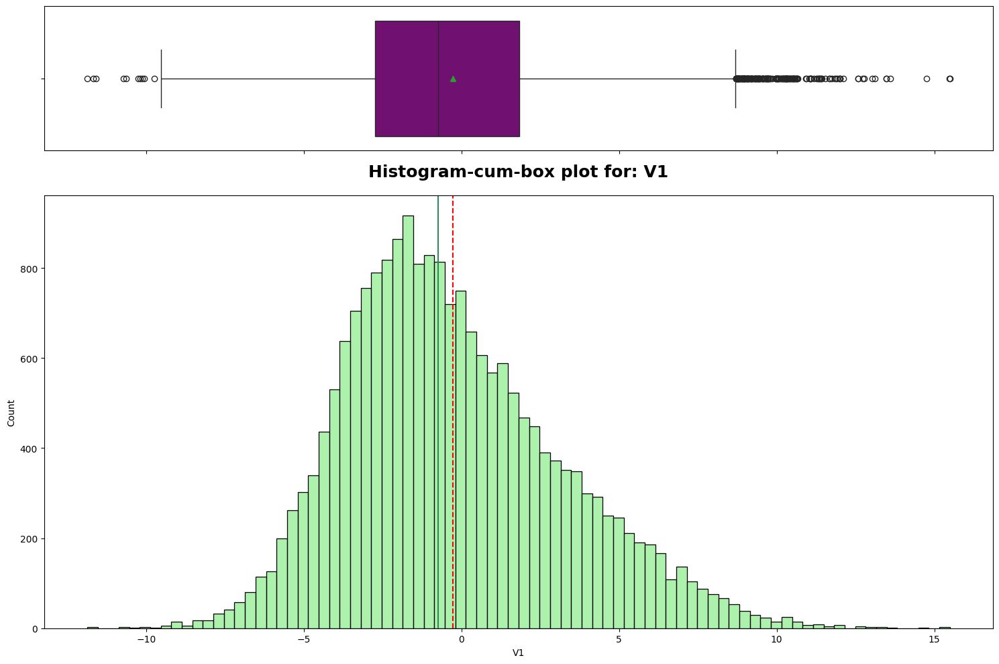

<Figure size 2000x800 with 0 Axes>

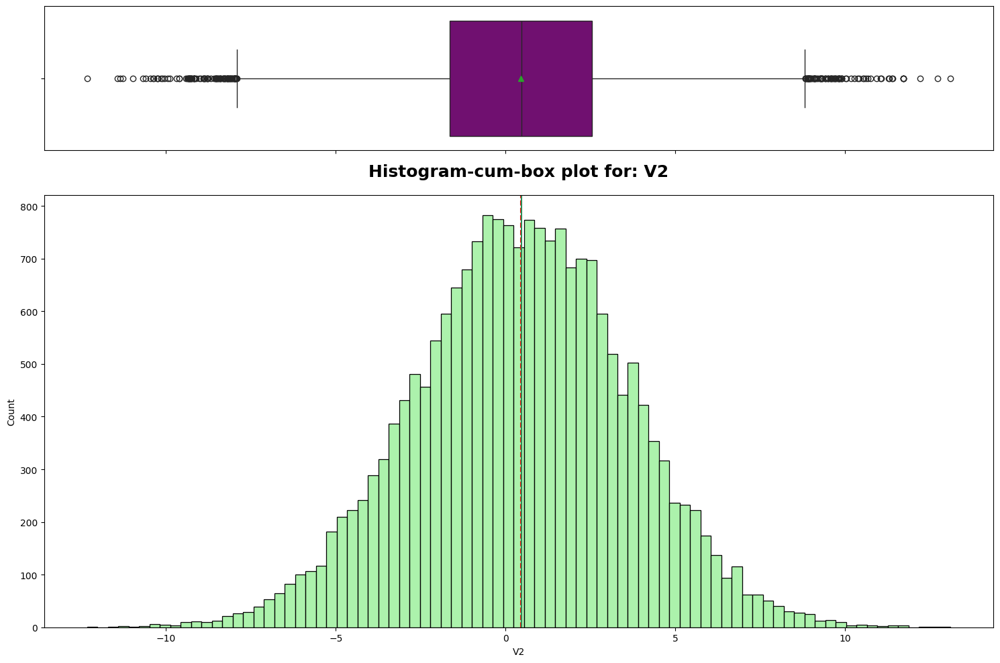

<Figure size 2000x800 with 0 Axes>

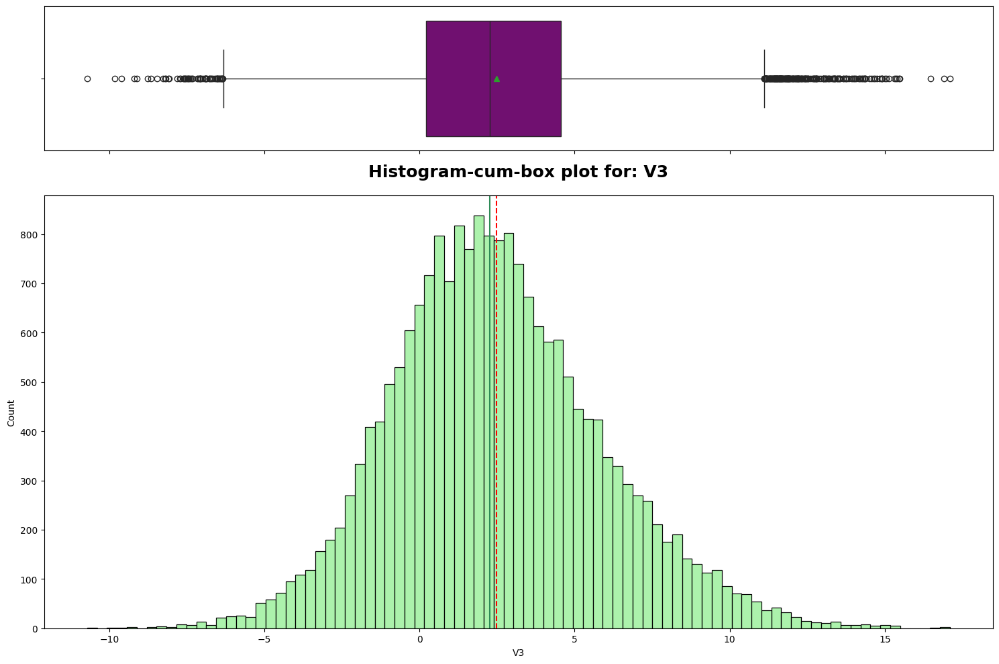

<Figure size 2000x800 with 0 Axes>

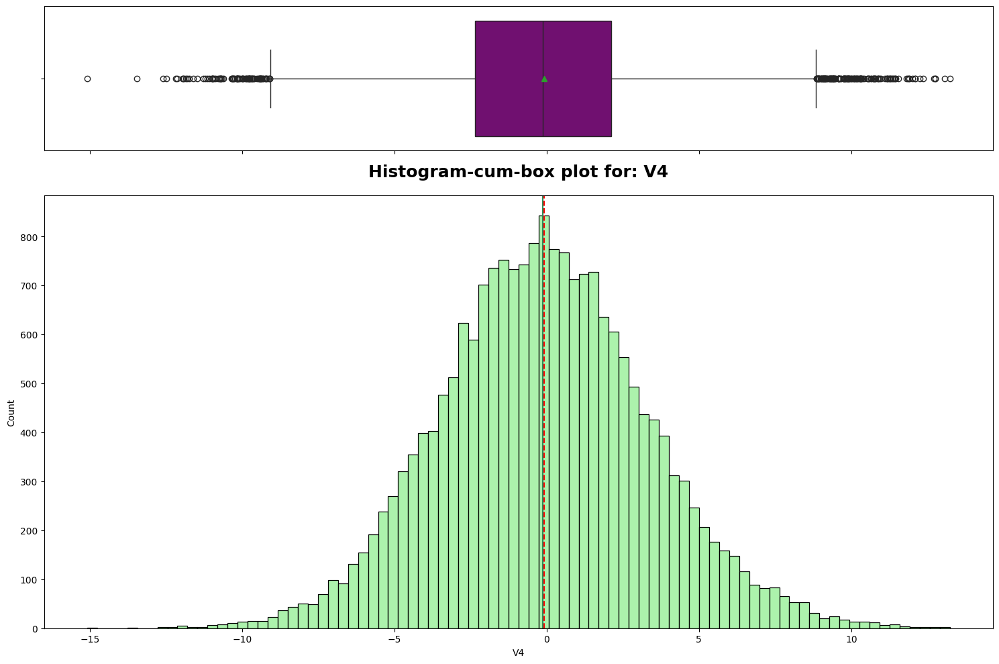

<Figure size 2000x800 with 0 Axes>

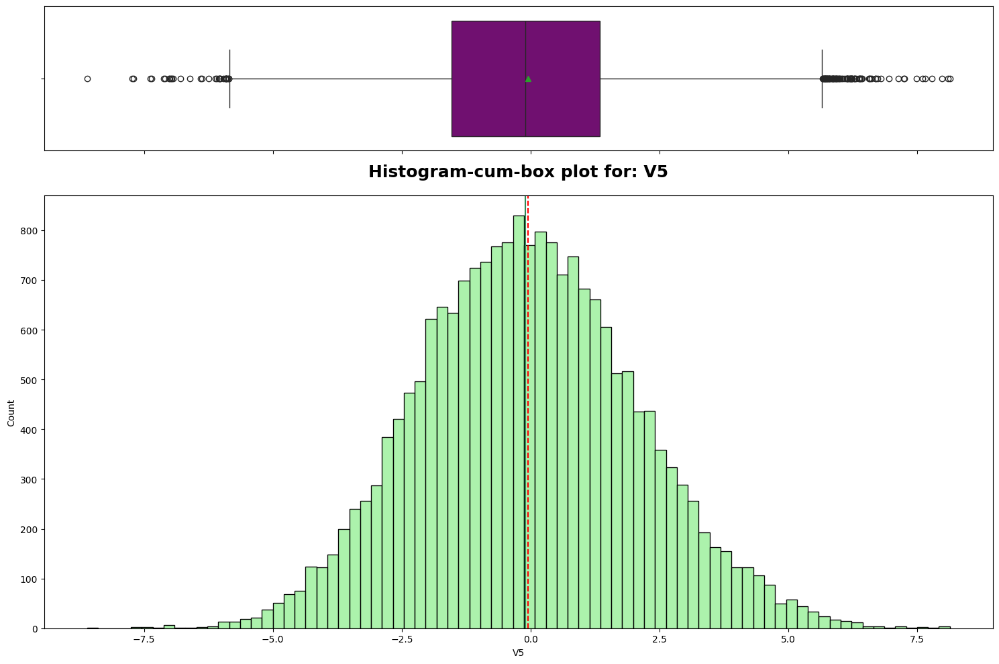

<Figure size 2000x800 with 0 Axes>

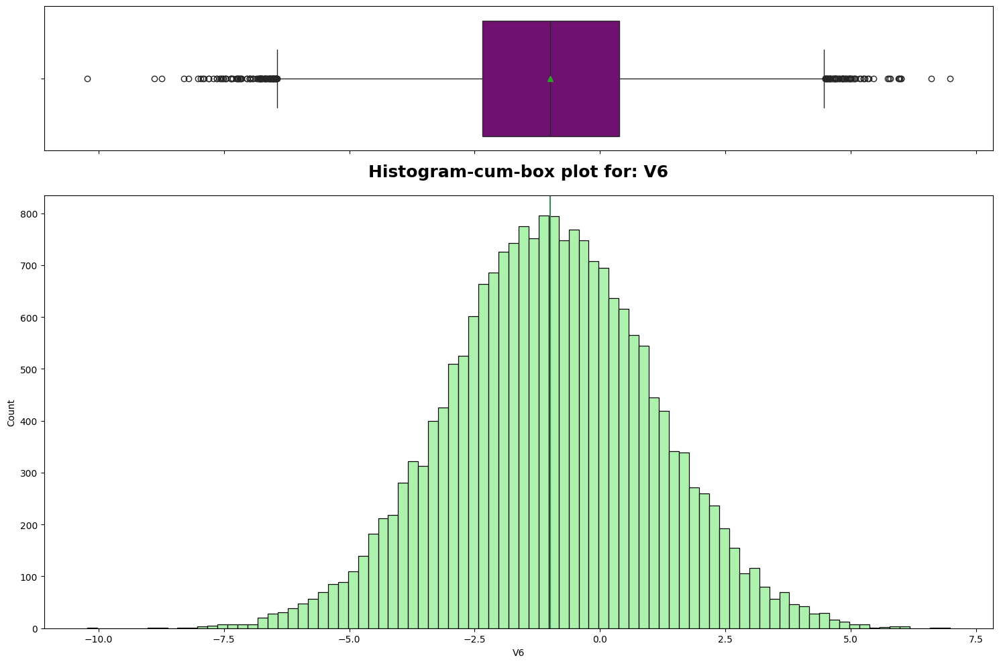

<Figure size 2000x800 with 0 Axes>

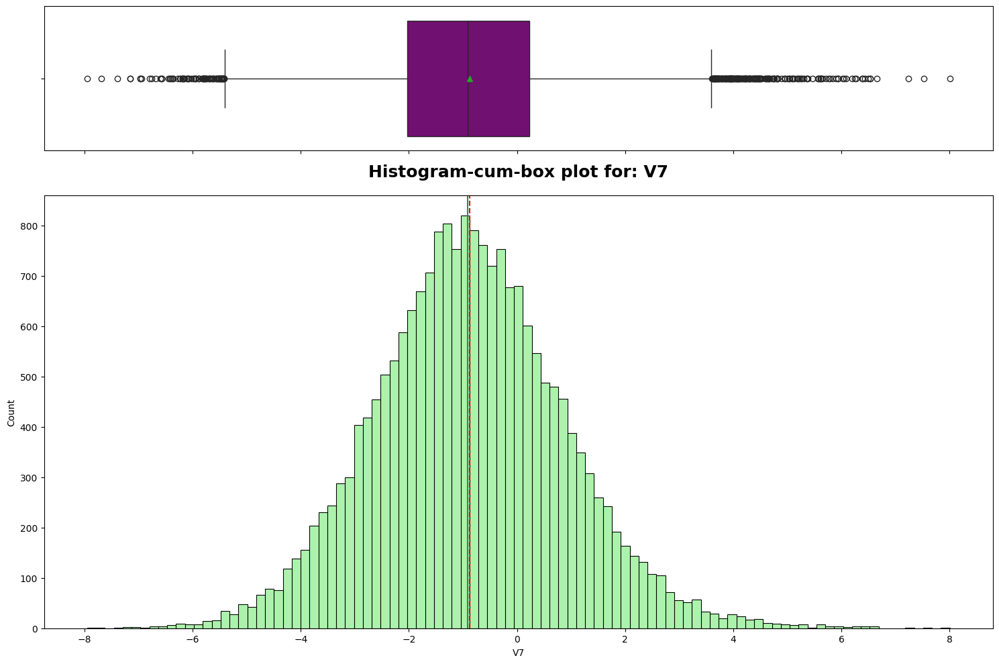

<Figure size 2000x800 with 0 Axes>

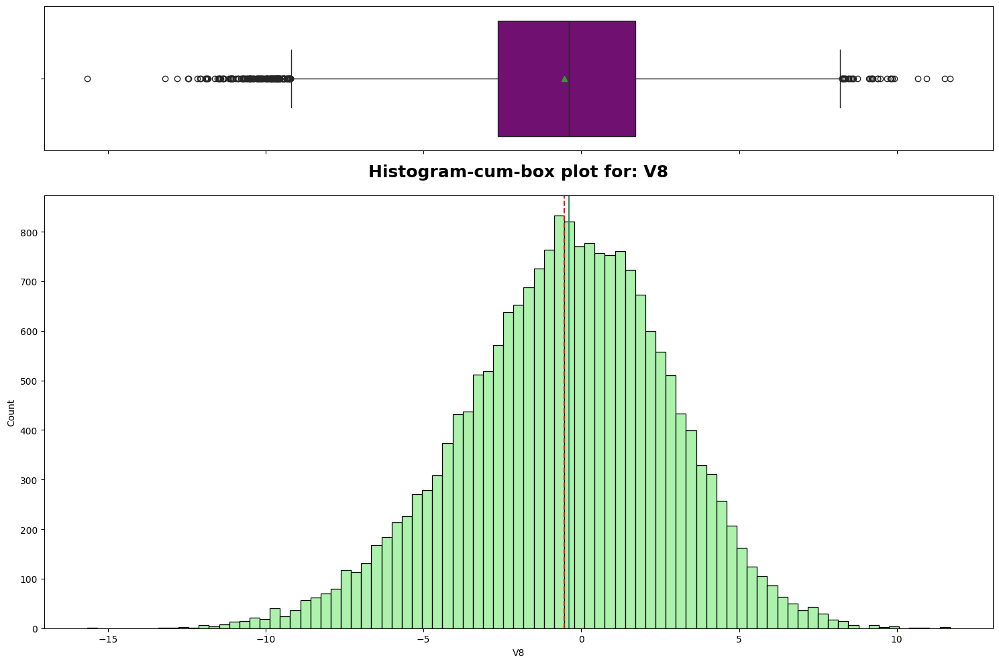

<Figure size 2000x800 with 0 Axes>

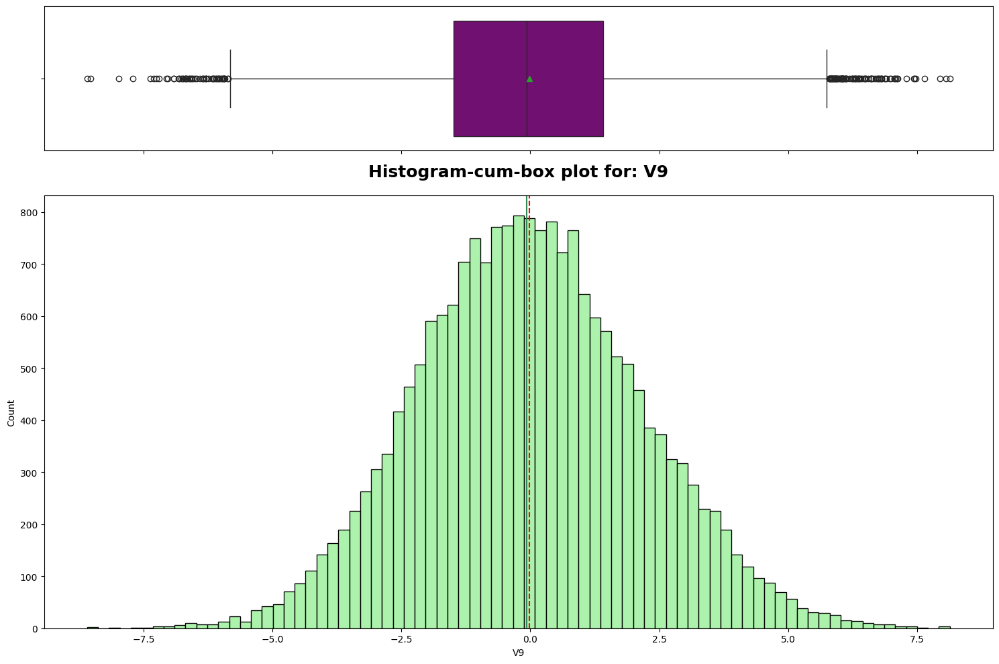

<Figure size 2000x800 with 0 Axes>

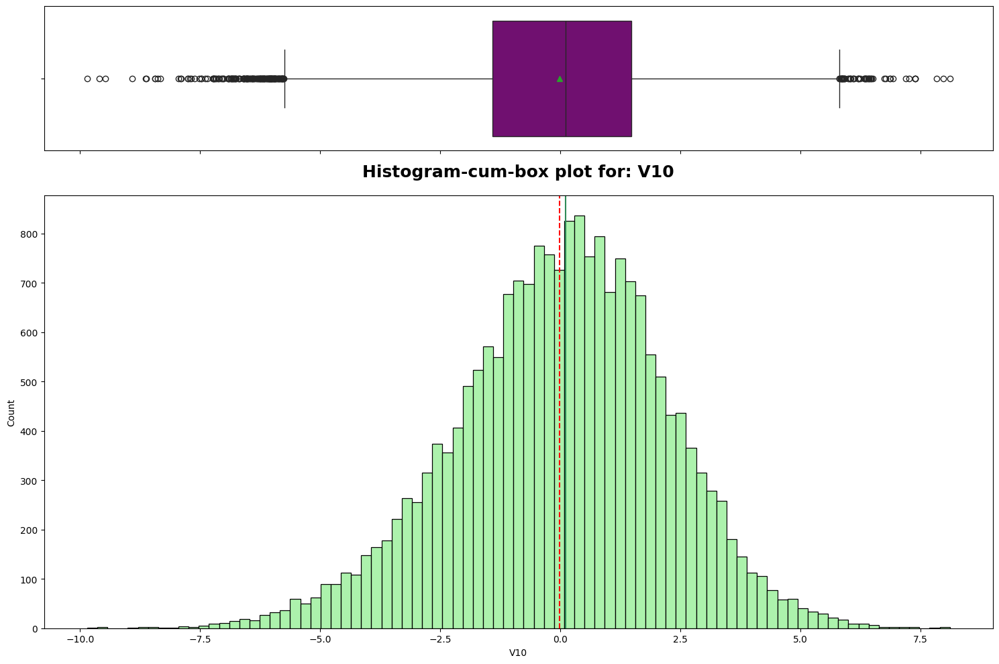

<Figure size 2000x800 with 0 Axes>

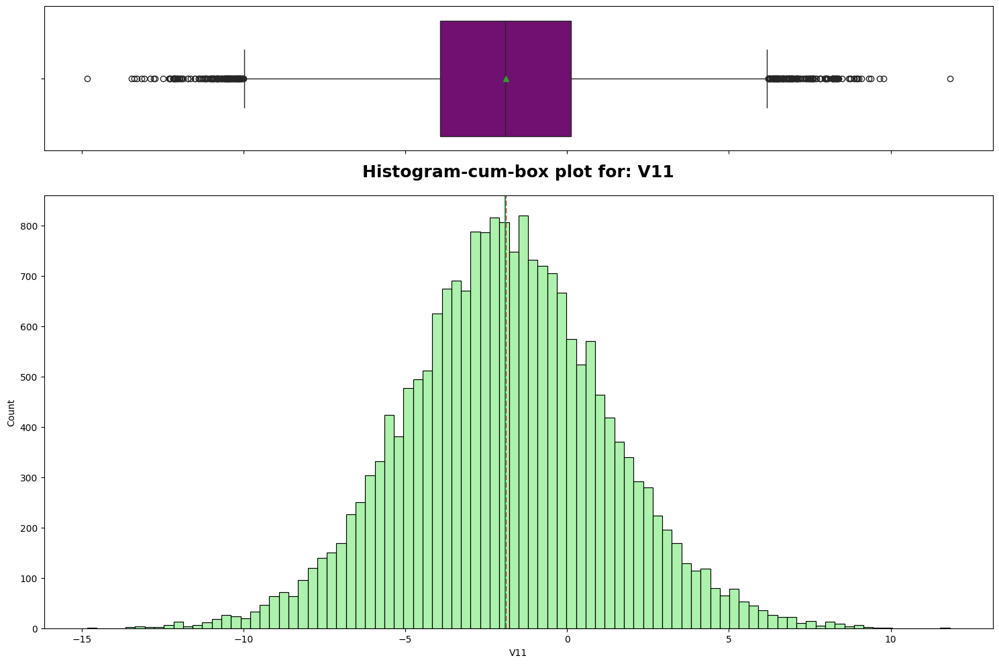

<Figure size 2000x800 with 0 Axes>

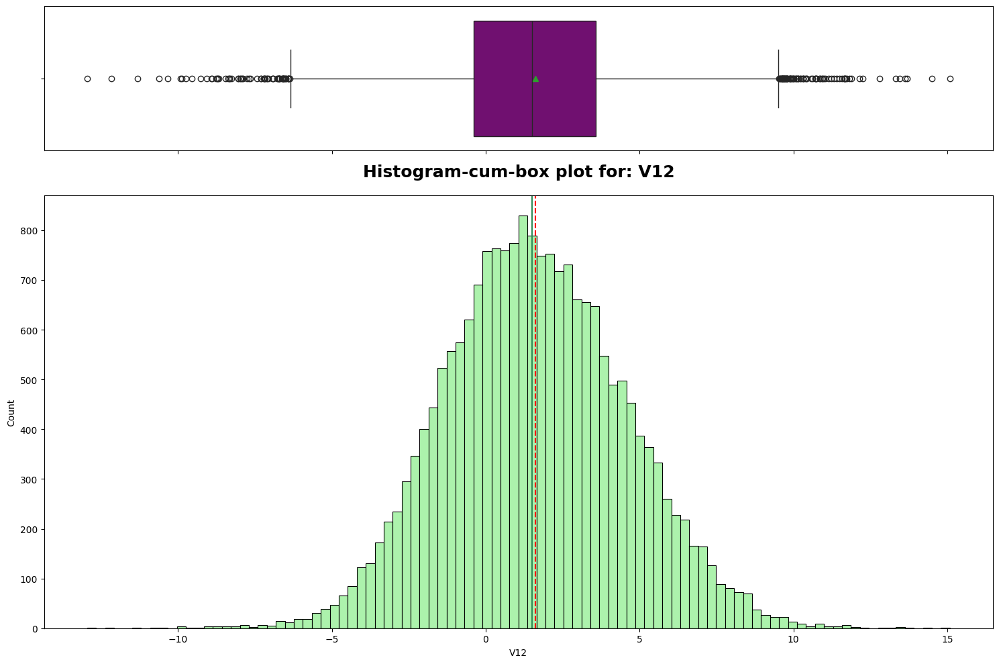

<Figure size 2000x800 with 0 Axes>

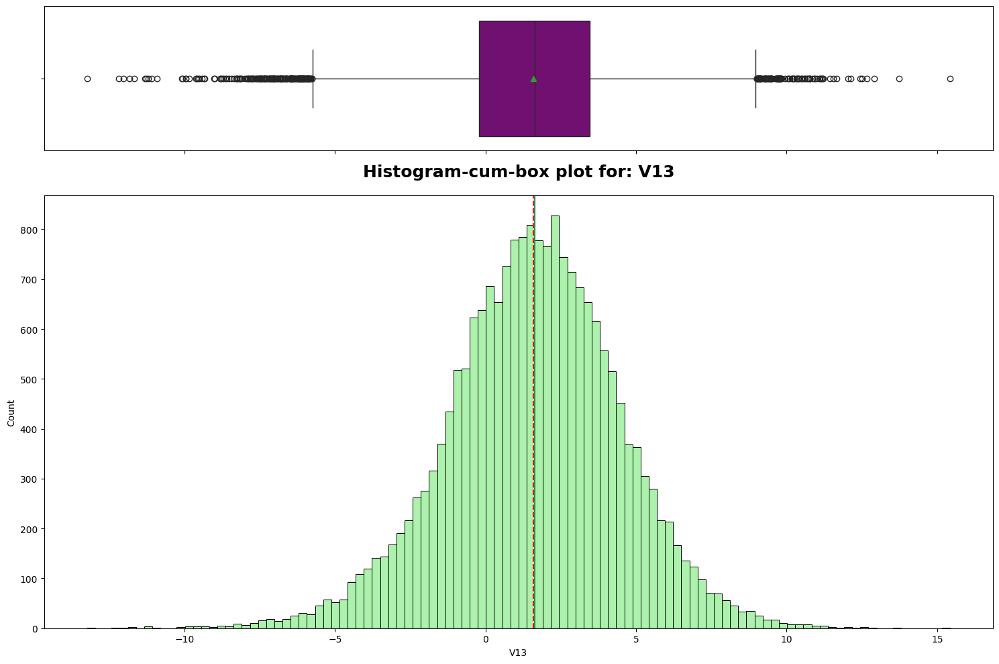

<Figure size 2000x800 with 0 Axes>

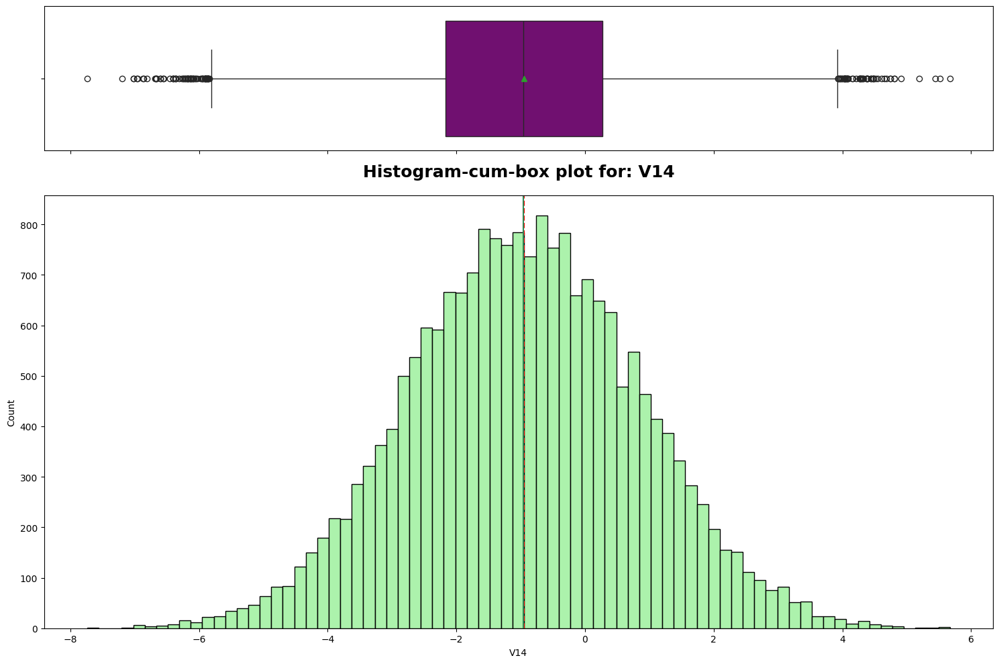

<Figure size 2000x800 with 0 Axes>

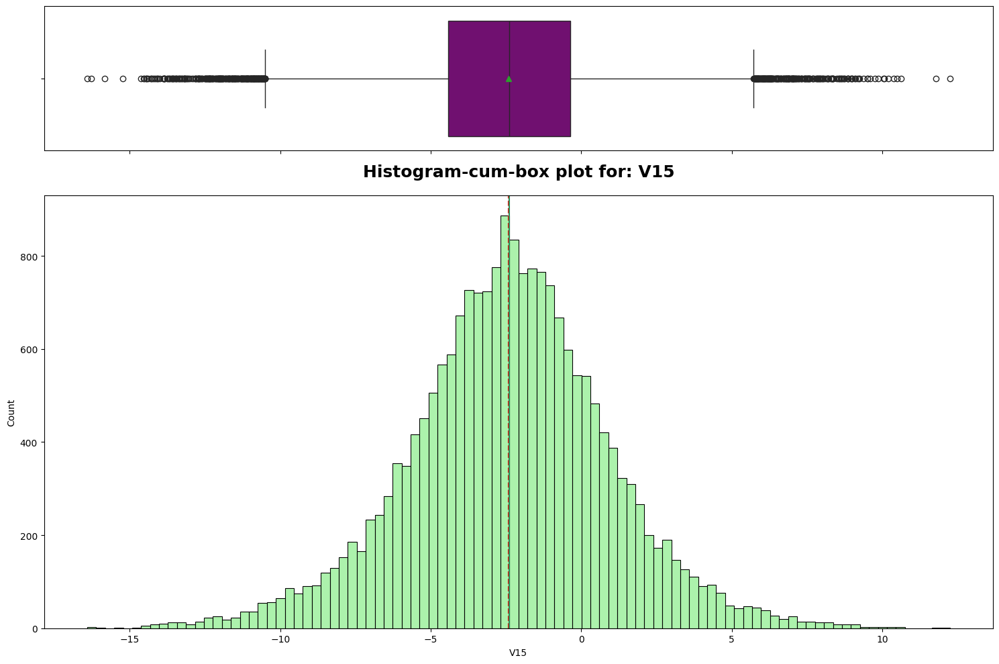

<Figure size 2000x800 with 0 Axes>

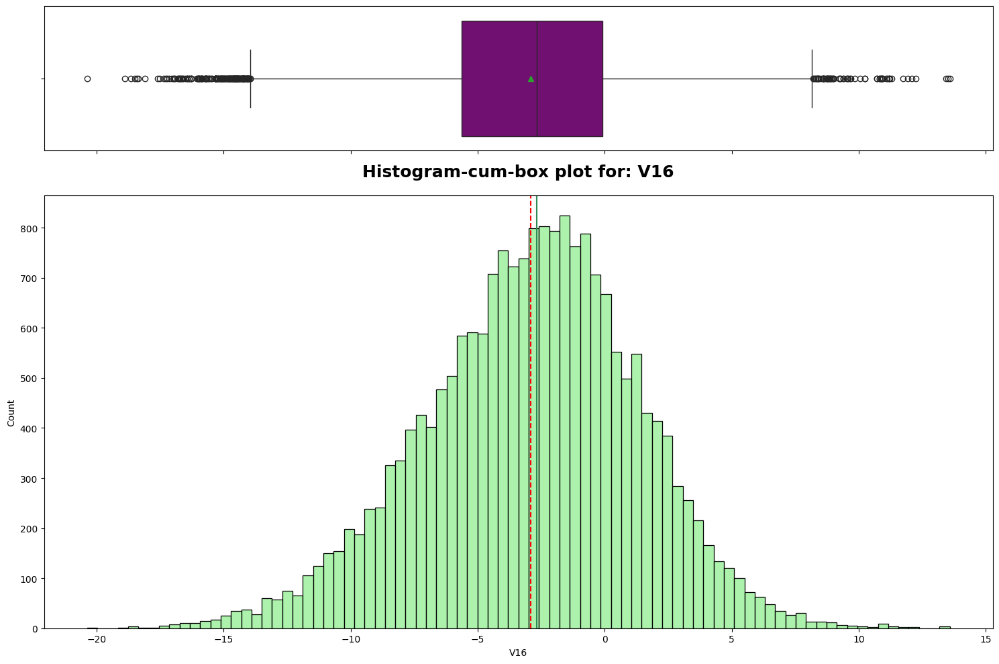

<Figure size 2000x800 with 0 Axes>

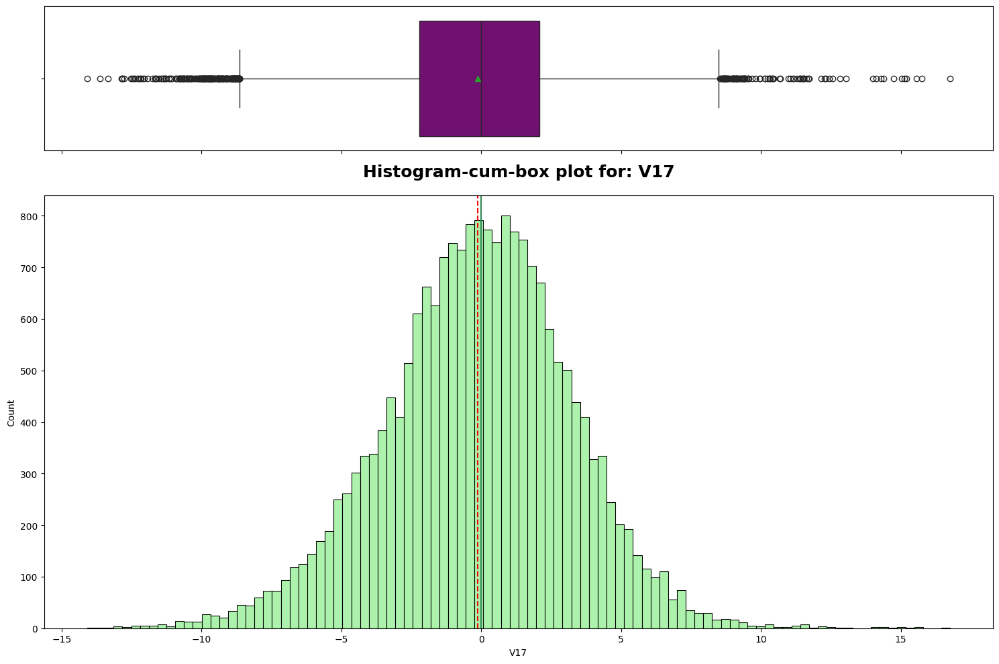

<Figure size 2000x800 with 0 Axes>

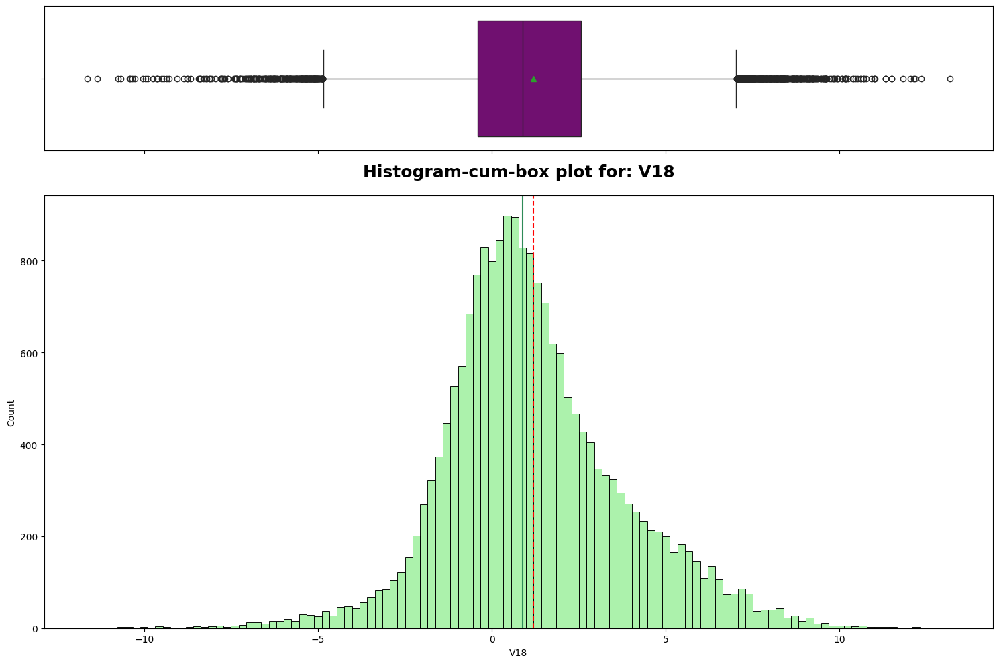

<Figure size 2000x800 with 0 Axes>

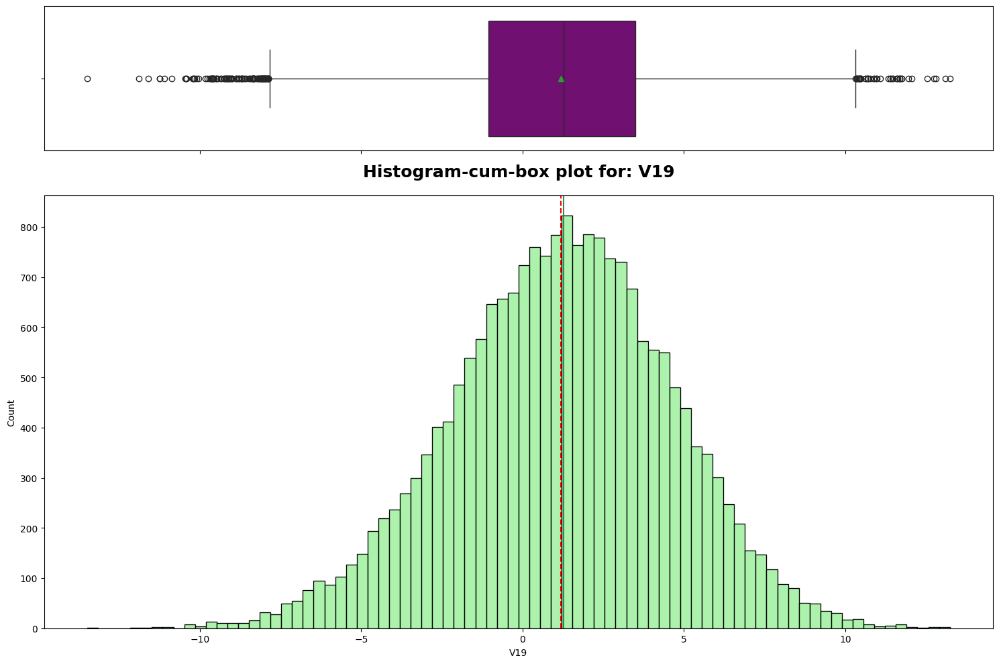

<Figure size 2000x800 with 0 Axes>

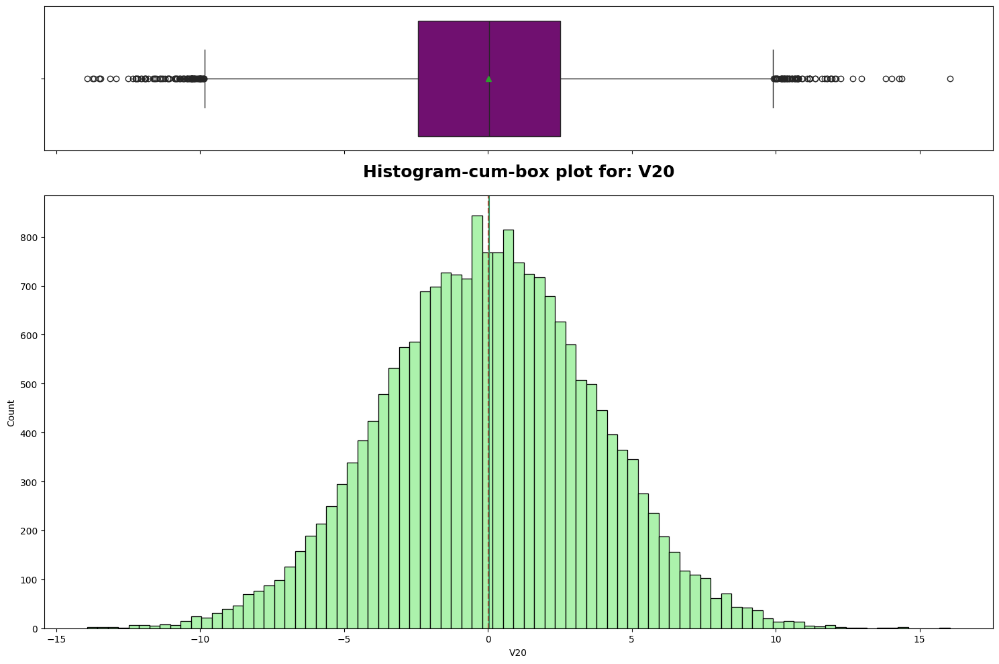

<Figure size 2000x800 with 0 Axes>

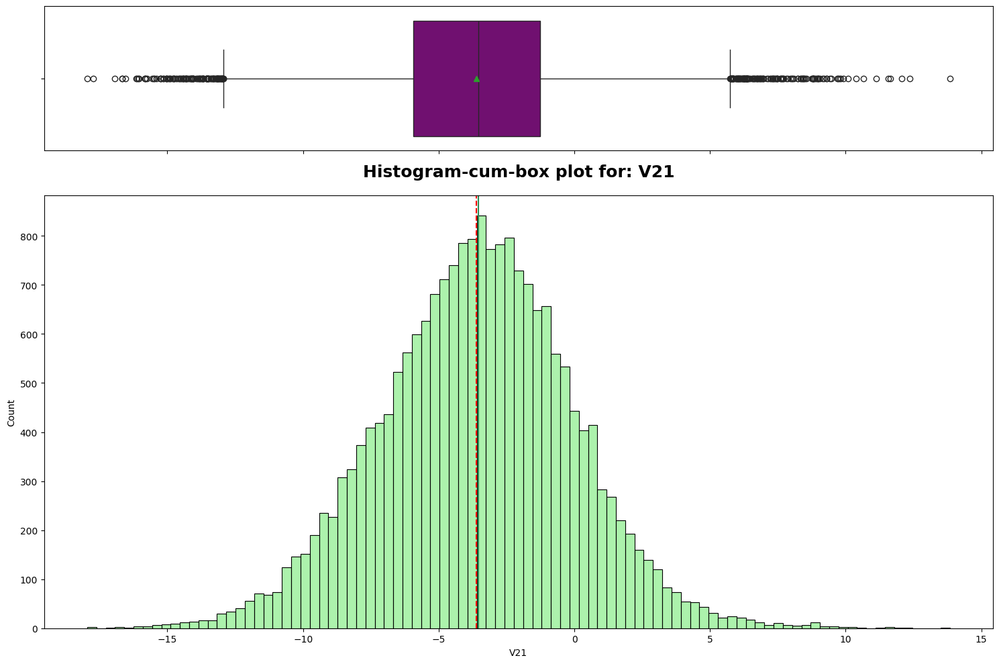

<Figure size 2000x800 with 0 Axes>

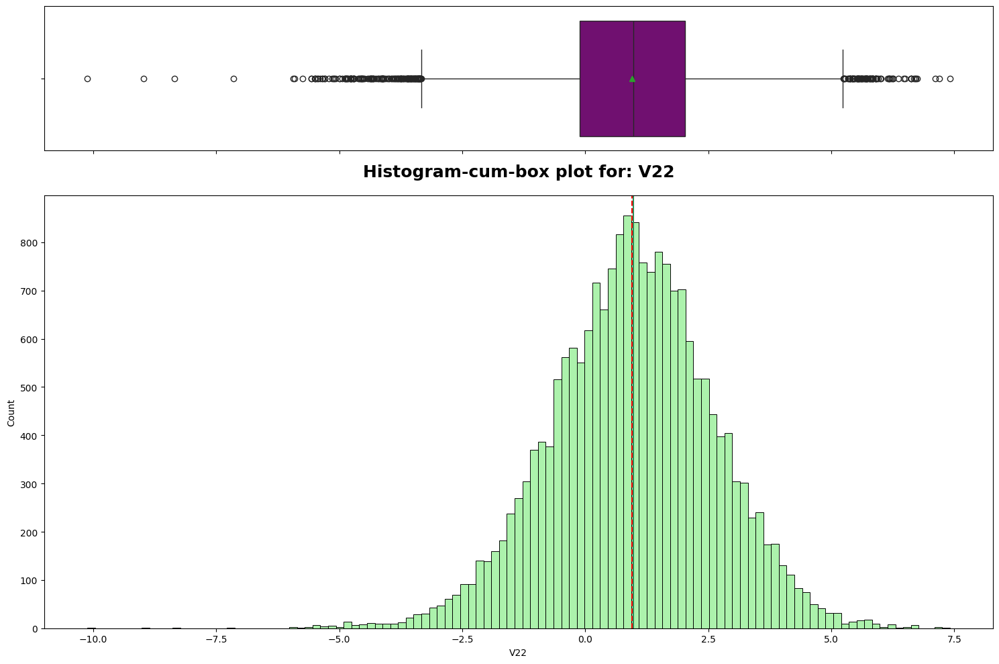

<Figure size 2000x800 with 0 Axes>

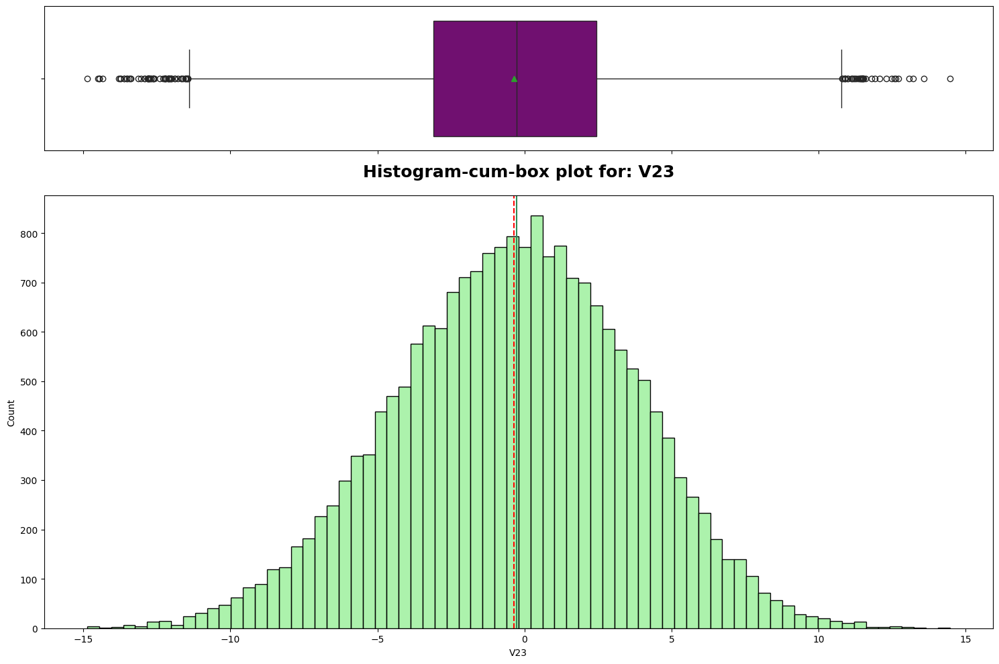

<Figure size 2000x800 with 0 Axes>

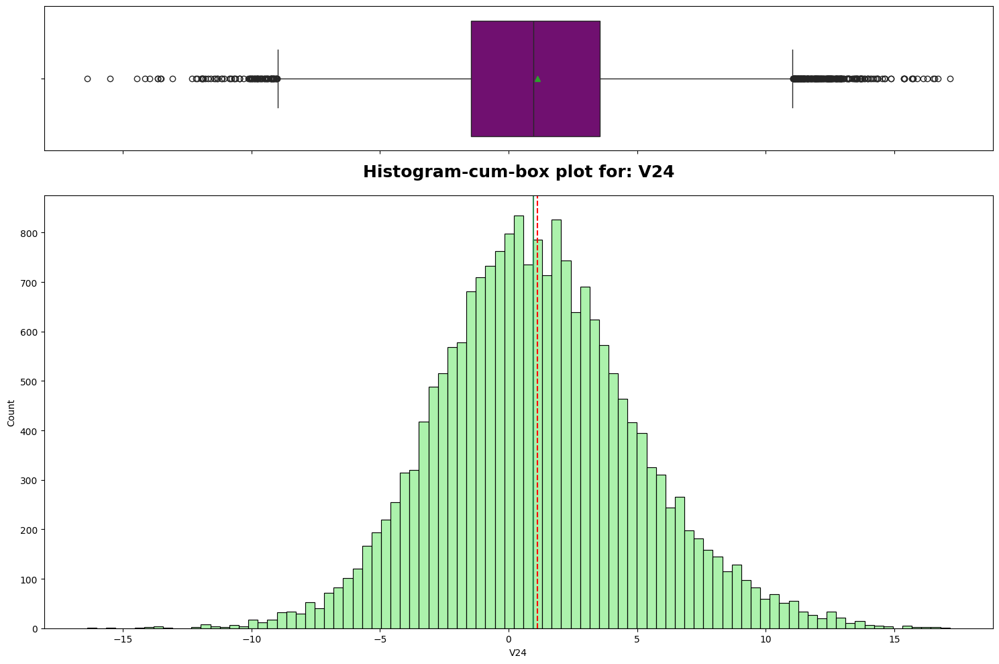

<Figure size 2000x800 with 0 Axes>

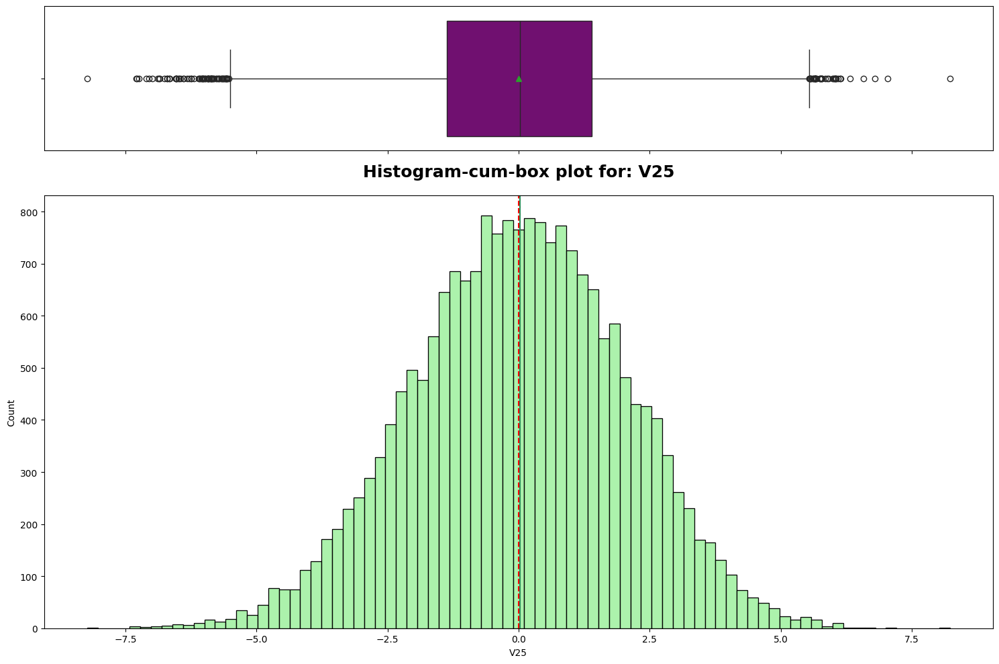

<Figure size 2000x800 with 0 Axes>

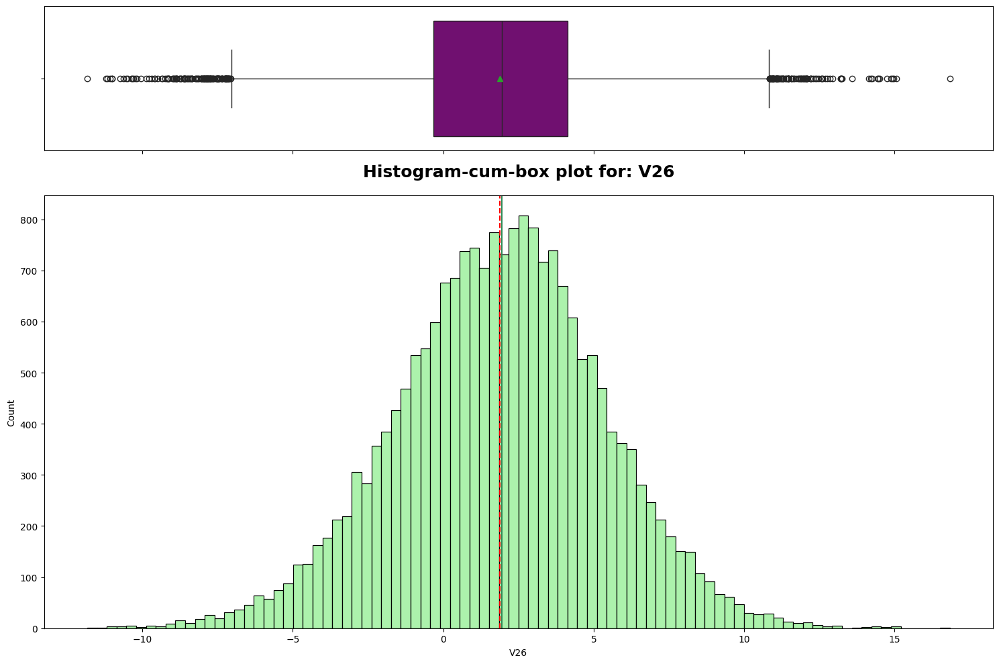

<Figure size 2000x800 with 0 Axes>

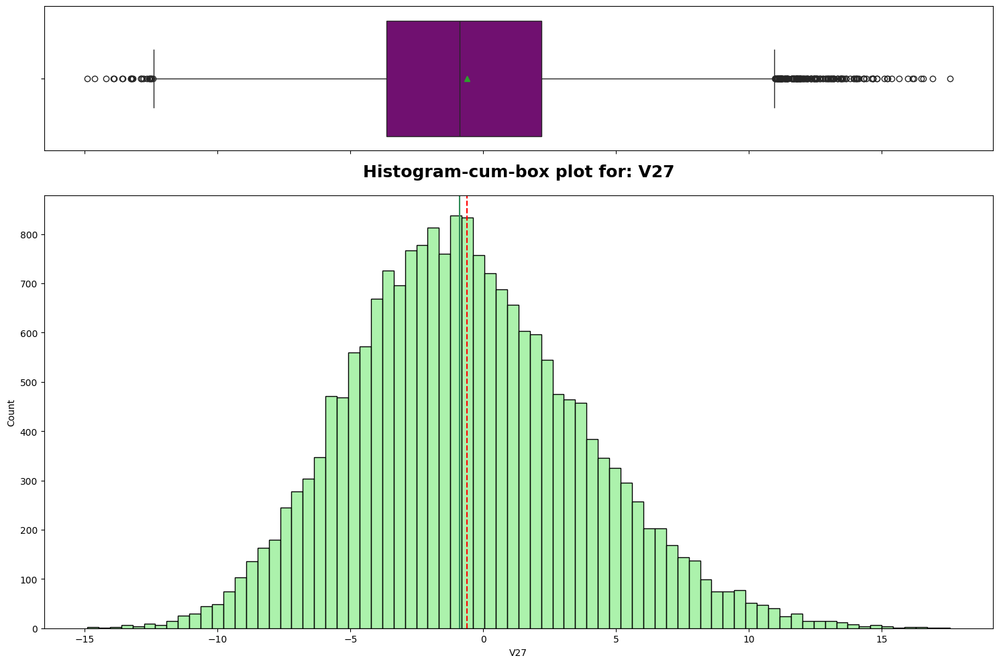

<Figure size 2000x800 with 0 Axes>

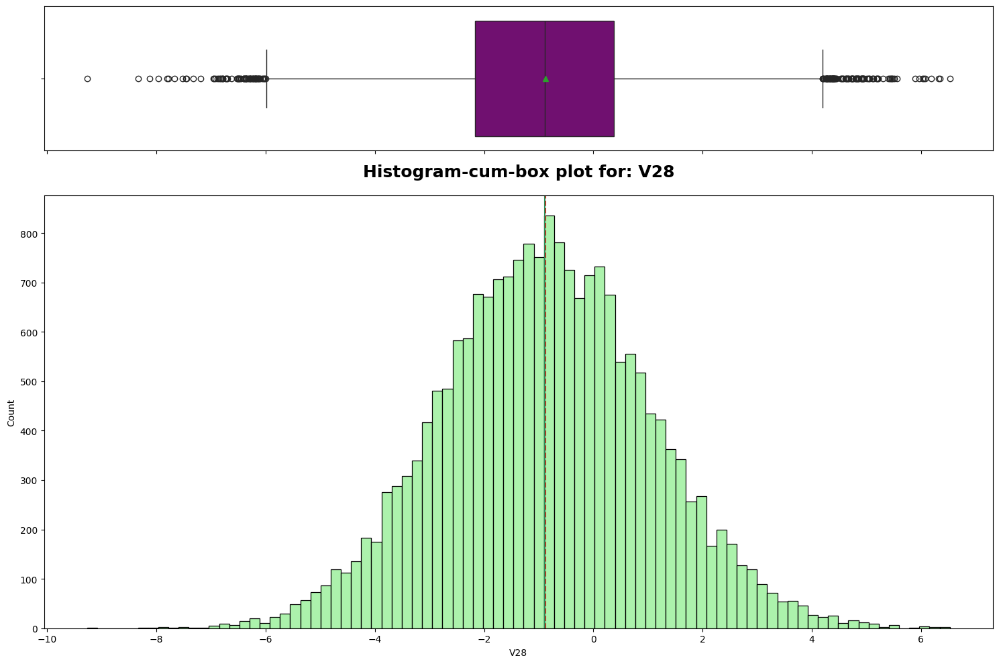

<Figure size 2000x800 with 0 Axes>

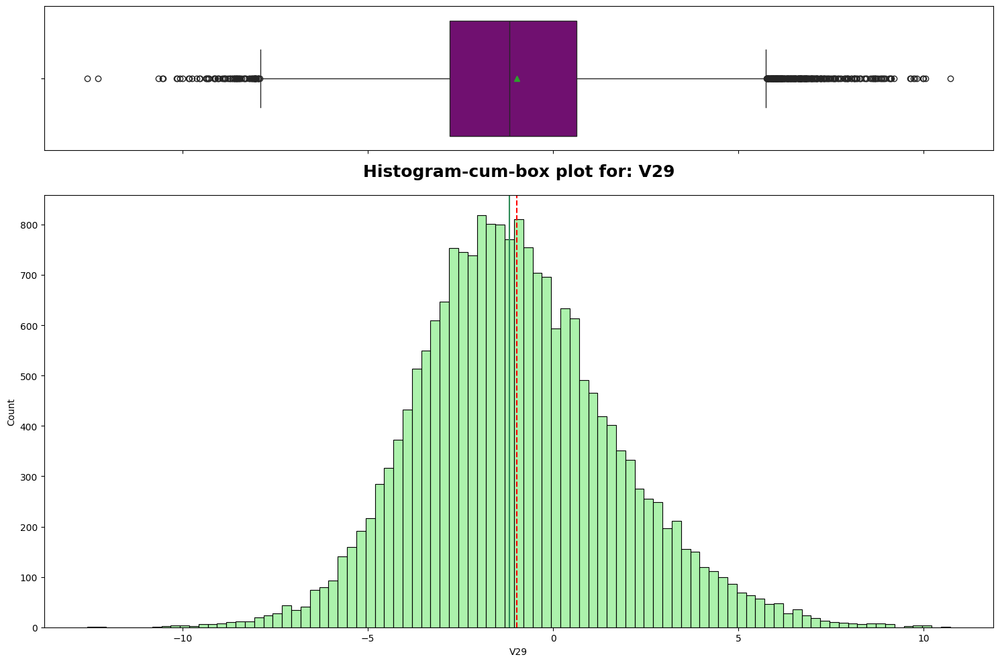

<Figure size 2000x800 with 0 Axes>

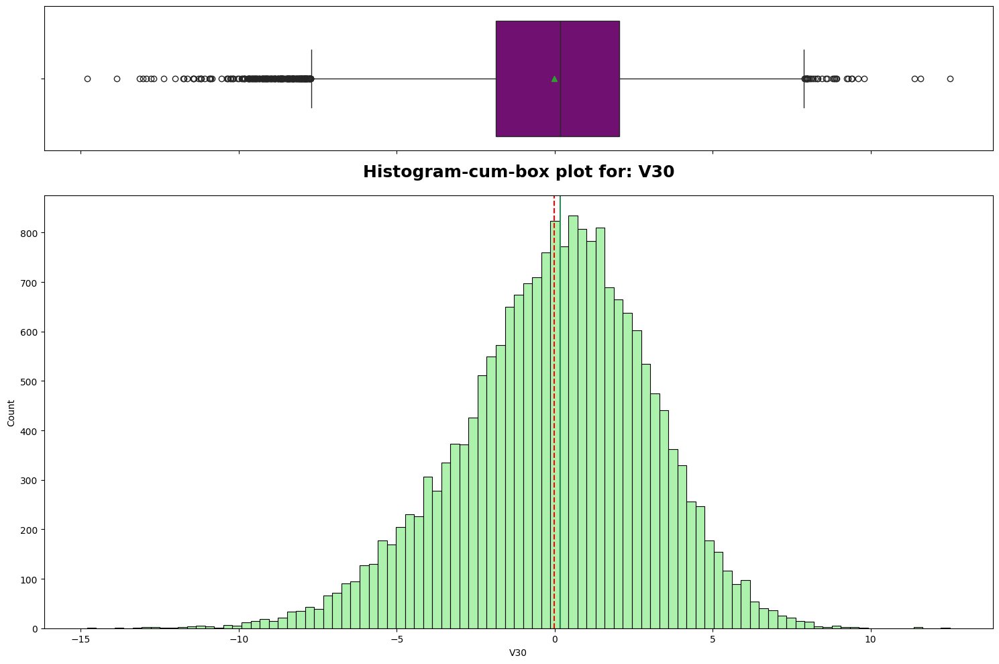

<Figure size 2000x800 with 0 Axes>

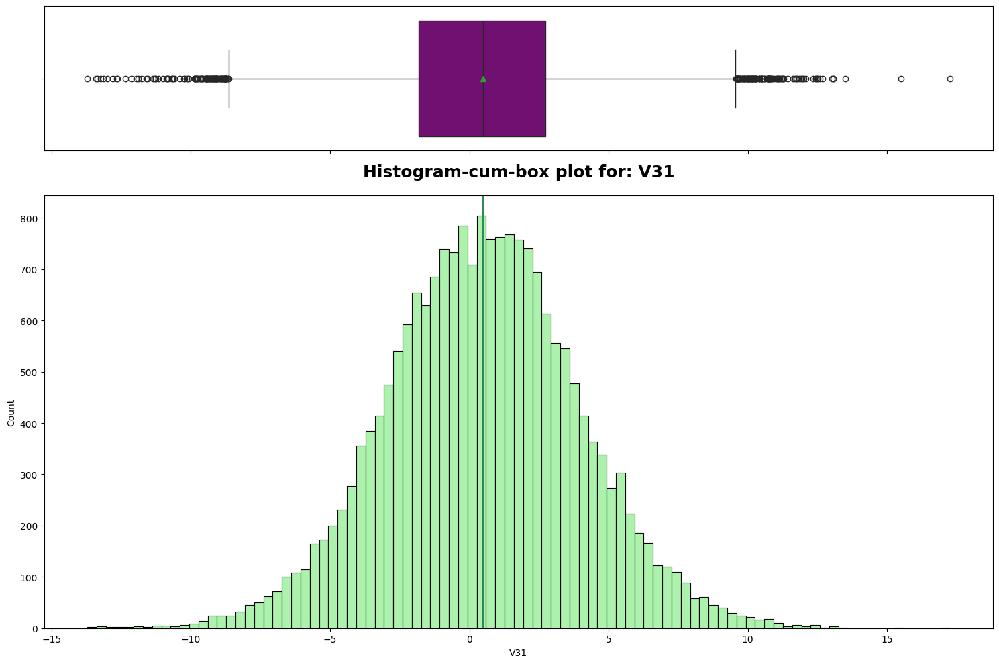

<Figure size 2000x800 with 0 Axes>

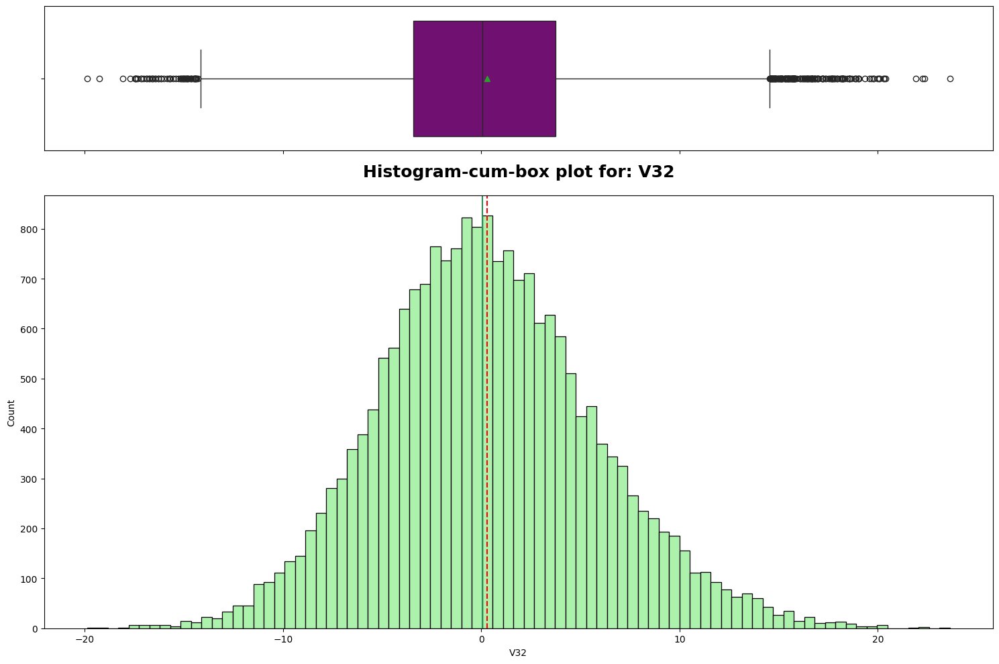

<Figure size 2000x800 with 0 Axes>

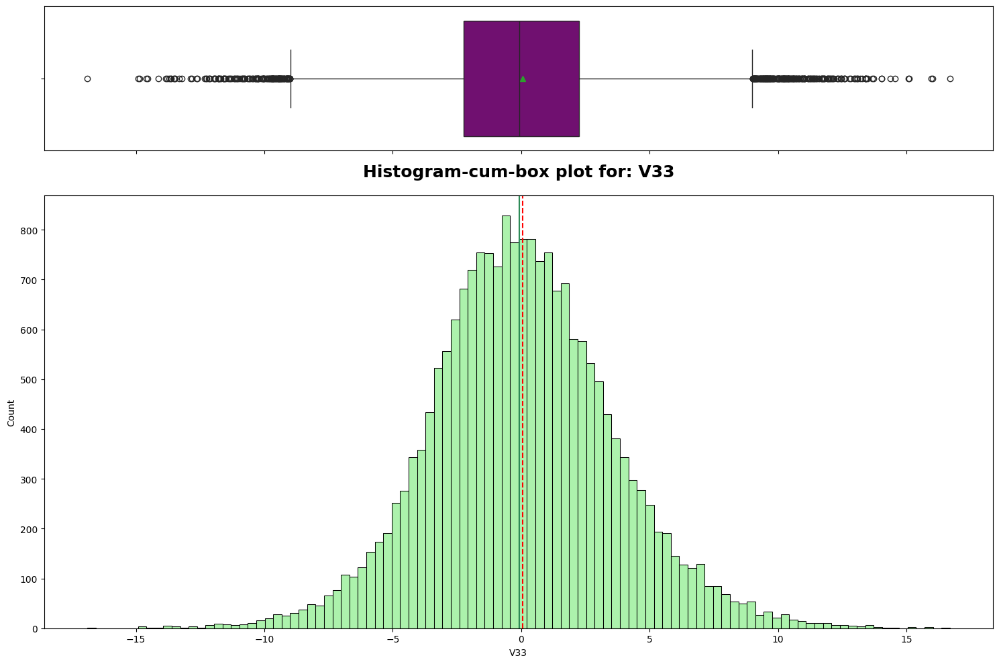

<Figure size 2000x800 with 0 Axes>

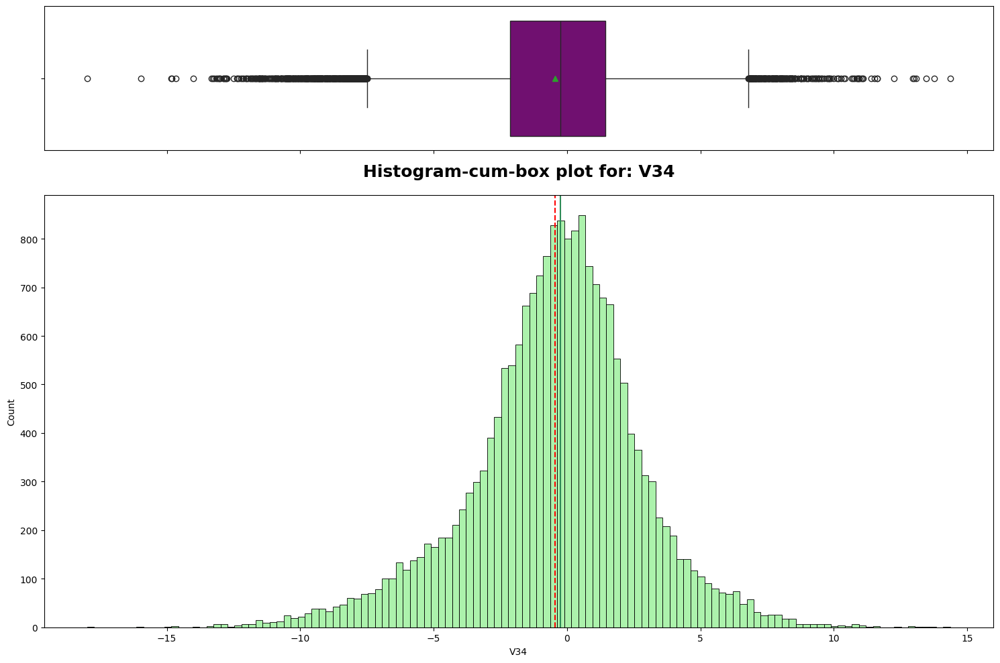

<Figure size 2000x800 with 0 Axes>

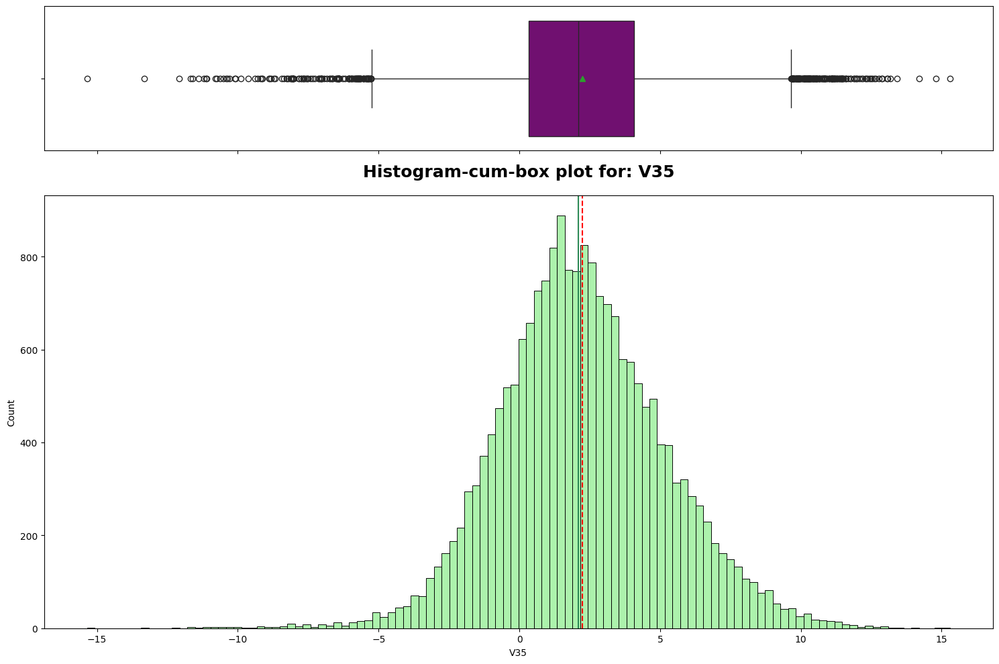

<Figure size 2000x800 with 0 Axes>

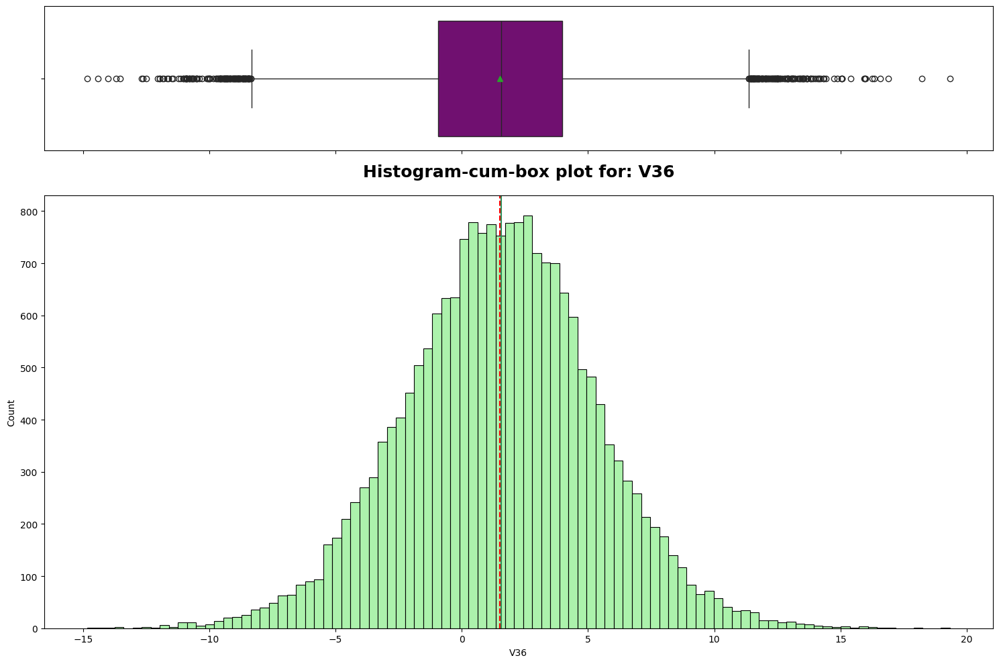

<Figure size 2000x800 with 0 Axes>

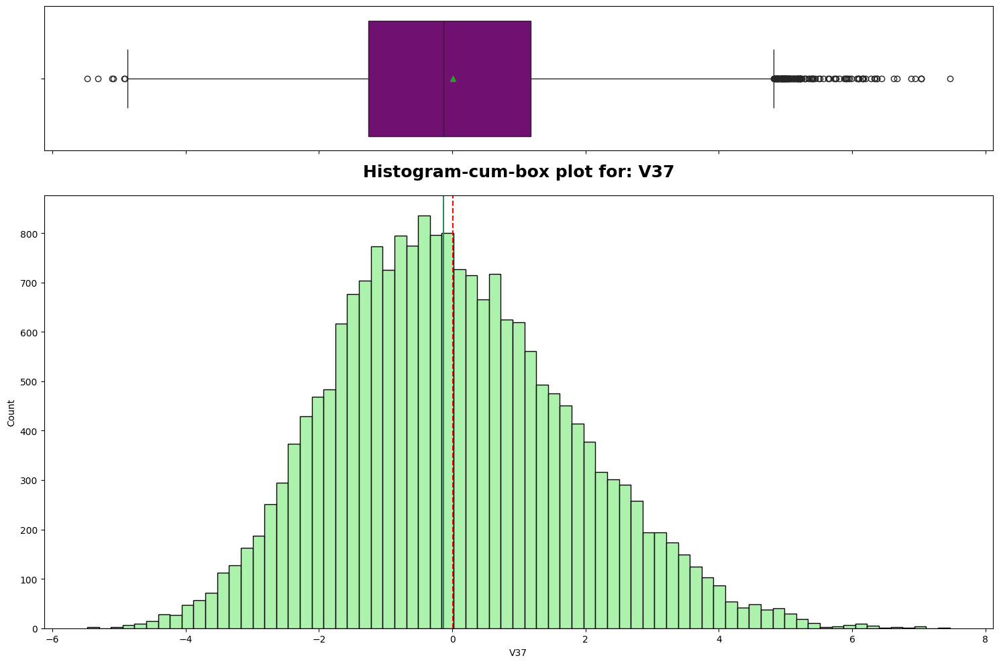

<Figure size 2000x800 with 0 Axes>

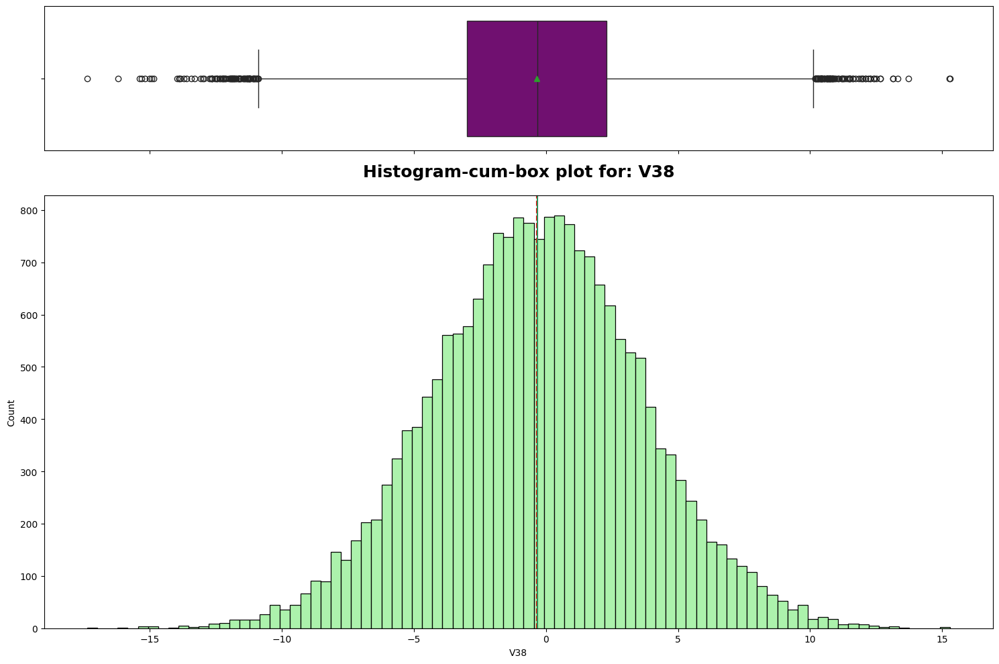

<Figure size 2000x800 with 0 Axes>

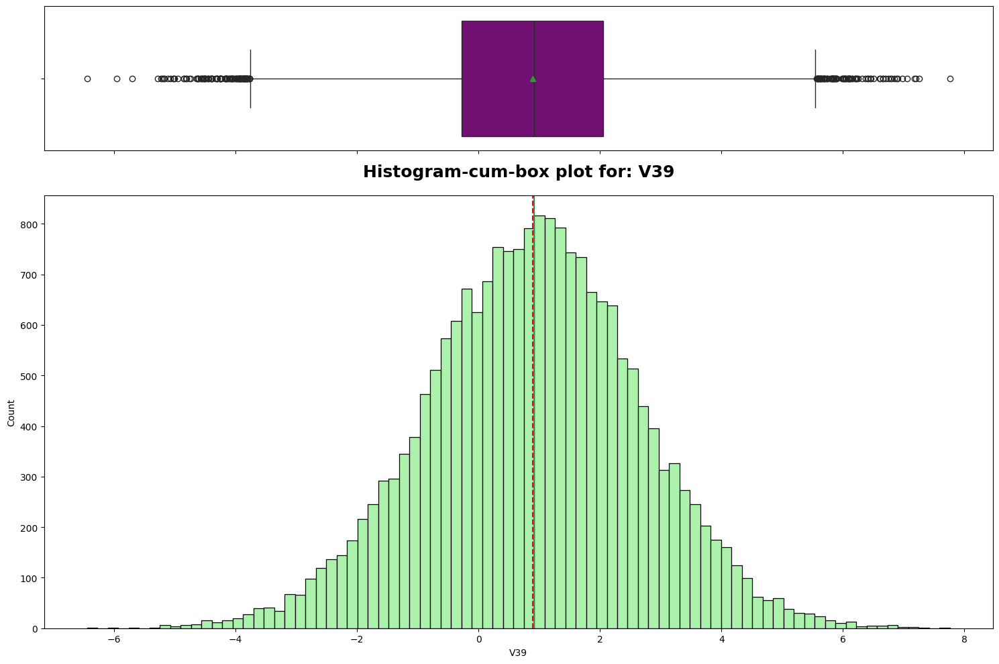

<Figure size 2000x800 with 0 Axes>

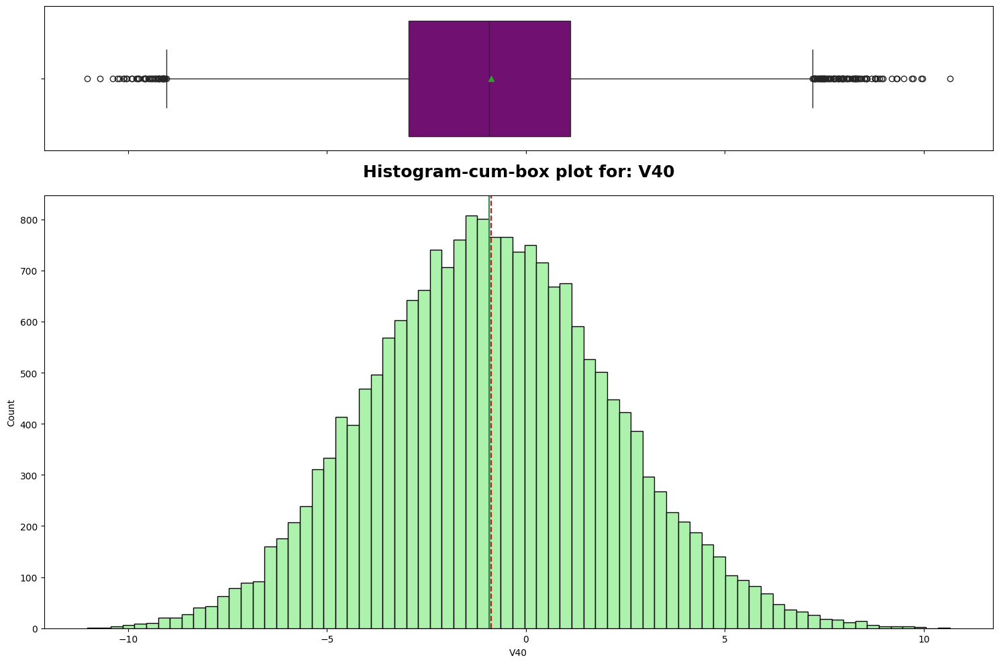

In [26]:
# Looping over all the independent variables
for i in range(1, 41):
    plt.figure(figsize=(20, 8))
    histogram_boxplot(train_data, 'V' + str(i))  # Plot histogram + boxplot
    plt.title(f'Histogram-cum-box plot for: V{i}', fontsize=18, fontweight='bold', pad=20)  # Add title above plot
    plt.tight_layout()
    plt.show()


1.   It is observed that almost all of the independent variables are uniformly distributed.
2.   All the boxplots are showing a few outliers on both sides — these are data points lying beyond the whiskers, but they appear minimal compared to the overall dataset size.
3. The median (black line in boxplot) and mean (green triangle) in maximum box plots nearly overlap at the center, confirming no significant skewness for those variables in the data.
4. Some of the variables like V1,V18 are slightly right skewed.

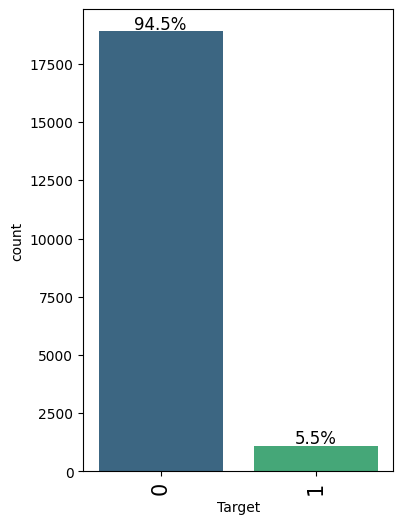

In [27]:
# Plotting countplot for categorical values
labeled_barplot(train_data, "Target", perc=True)

It is observed that nearly 6% of generators are resulting in failure.

## Bivariate Analysis

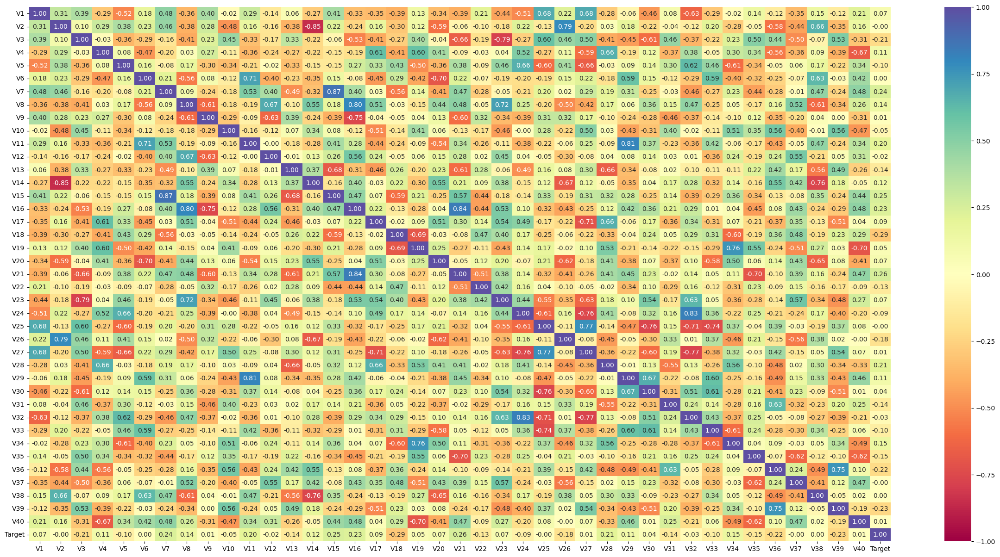

In [28]:
# Setting the figure size
plt.figure(figsize=(30, 15))
# Plotting the heatmap
sns.heatmap(
    train_data.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral"
)
plt.show()

* These pairs of variables are observed to have strong negative correlation:(V2,V14), (V3,V23), (V38,V14), (V16,V9), (V25,V30), (V32,V27),(V24,V27)

* These pairs of variables are observed to have strong positive correlation:
(V2,V26), (V7,V15), (V8,V16), (V11,V29), (V16,V21), (V32,V24), (V27,V25),
(V39,V36), (V19,V34)

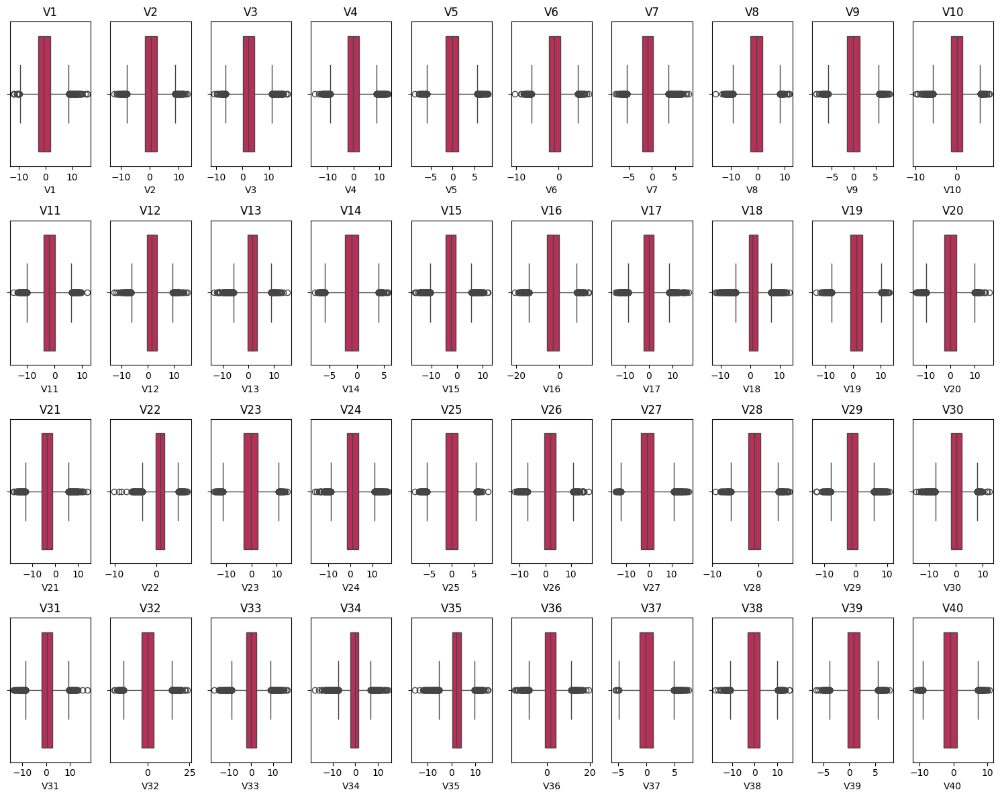

In [29]:
# Outlier Detection using Boxplots
# Select only numerical columns from the dataset, excluding the target variable
columns = [c for c in train_data.select_dtypes(include=np.number).columns if c != 'Target']
# Set the overall figure size for better visibility
plt.figure(figsize=(15, 12))
# Loop through each numerical column to create individual boxplots
for i, variable in enumerate(columns):
    # Define the subplot position (4 rows x 10 columns grid layout)
    plt.subplot(4, 10, i + 1)
    # Create a boxplot for the current variable
    # 'whis=1.5' sets the whisker length (standard definition for detecting outliers)
    # 'palette="rocket"' defines the color theme
    sns.boxplot(x=train_data[variable], whis=1.5, palette="rocket")
    # Adjust subplot spacing to avoid overlapping text and plots
    plt.tight_layout()
    # Add the column name as the subplot title
    plt.title(variable)
# Display all boxplots
plt.show()

* Most variables appear to have symmetrical distributions (median near the center of the box).

* However, some features show slightly skewed distributions where whiskers or outliers are more frequent on one side.
* Features such as V3, V14, V16, V26, V31, V34, and V38 show longer whiskers, suggesting higher variability or a wider range of values.

* Others like V7, V9, V13, V23 have tighter boxes, indicating less variation.

## Multivariate Analysis

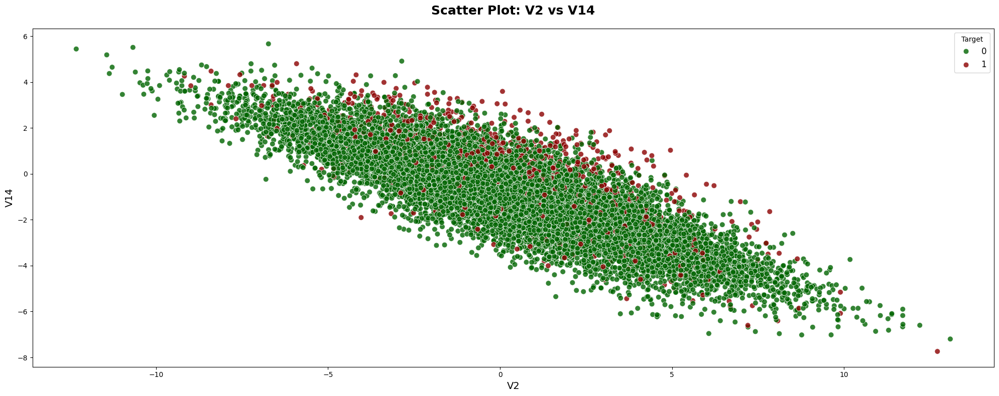

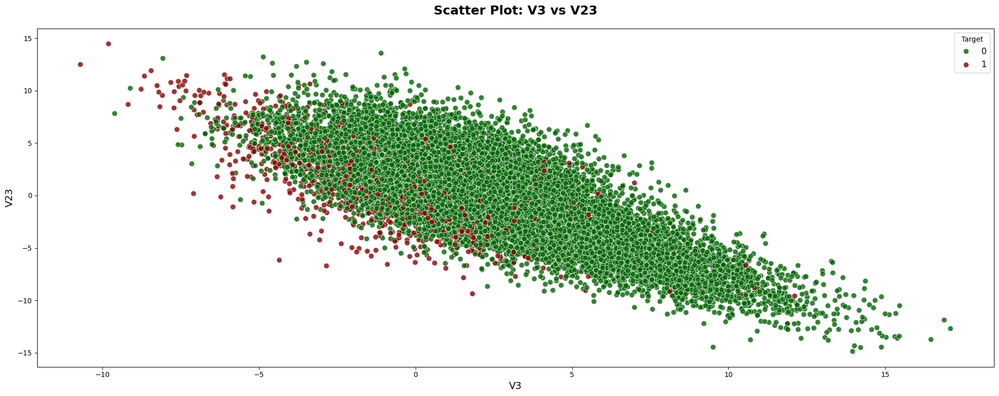

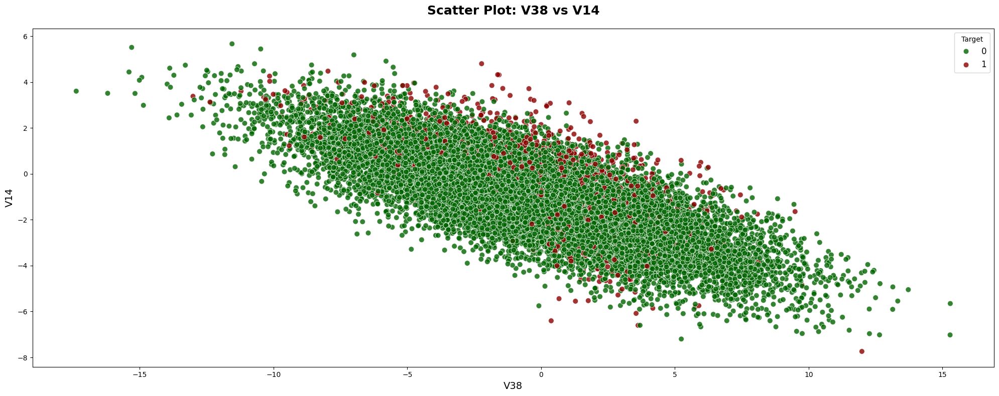

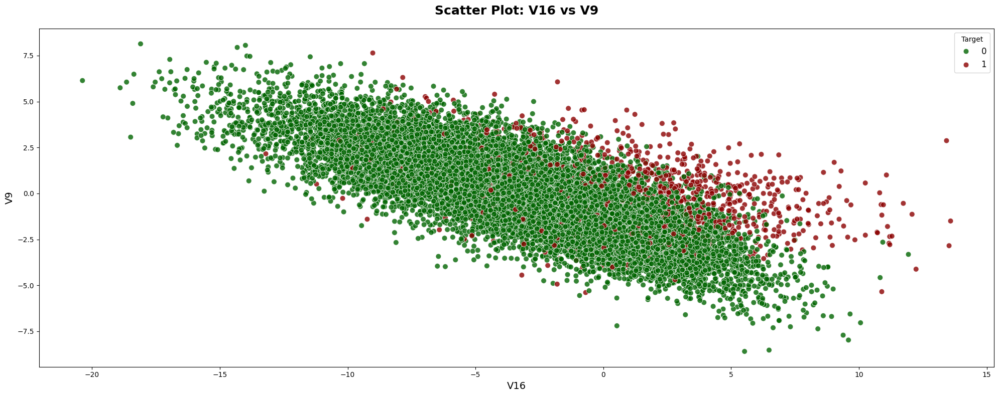

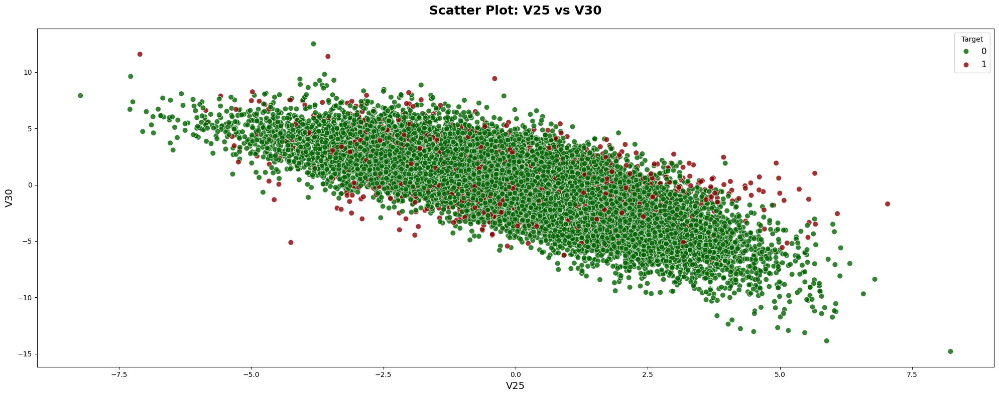

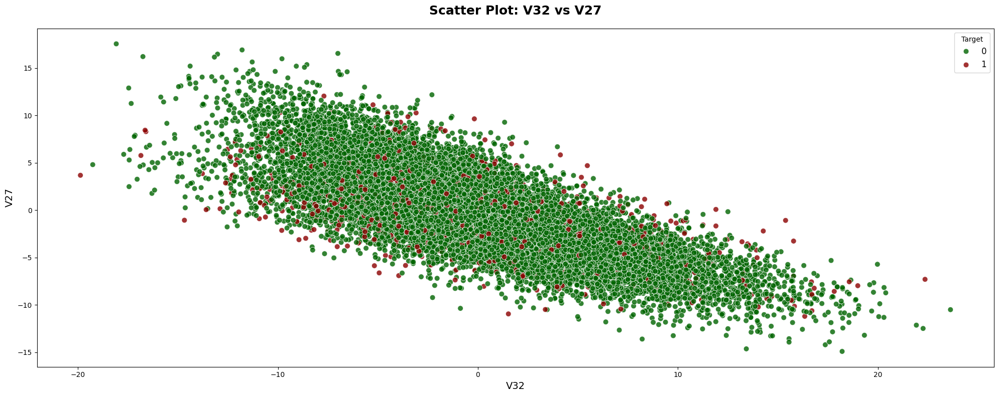

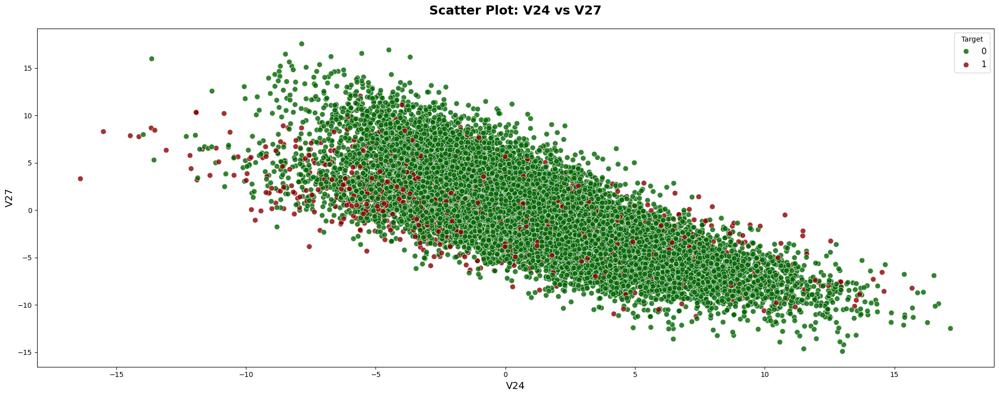

In [30]:
# Dictionary of variable pairs for scatter plots
# Each key-value pair represents (x-variable, y-variable)
v_dict = {
    'V2': 'V14',
    'V3': 'V23',
    'V38': 'V14',
    'V16': 'V9',
    'V25': 'V30',
    'V32': 'V27',
    'V24': 'V27'
}

# Looping through each variable pair in the dictionary
for k, v in v_dict.items():
    # Creating a new figure for each scatter plot with specified size
    plt.figure(figsize=(20, 8))

    # Plotting scatter plot for the current variable pair
    sns.scatterplot(
        data=train_data,         # Using training dataset
        x=k,                     # X-axis variable
        y=v,                     # Y-axis variable
        hue='Target',            # Coloring points based on target class
        palette=['darkgreen', 'darkred'],  # Defining custom colors for classes
        alpha=0.8,               # Setting transparency for better visibility
        s=60                     # Setting point size
    )

    # Adding title and axis labels with formatting
    plt.title(f'Scatter Plot: {k} vs {v}', fontsize=18, fontweight='bold', pad=20)
    plt.xlabel(k, fontsize=14)
    plt.ylabel(v, fontsize=14)

    # Displaying legend with title and formatting
    plt.legend(title='Target', fontsize=12)

    # Adjusting spacing to prevent label overlap
    plt.tight_layout()

    # Displaying the scatter plot
    plt.show()


Strong negative correlation is observed between these pairs of variables.
The red points (Target = 1) are relatively sparse but follow the same overall trend as the green ones.


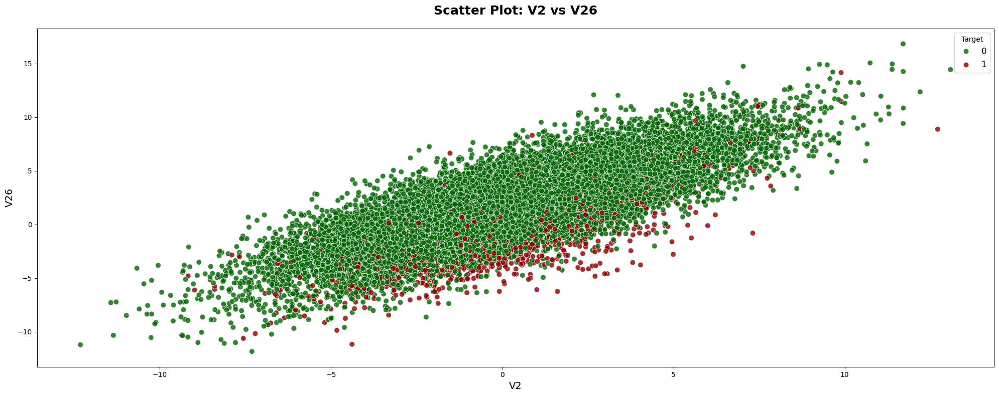

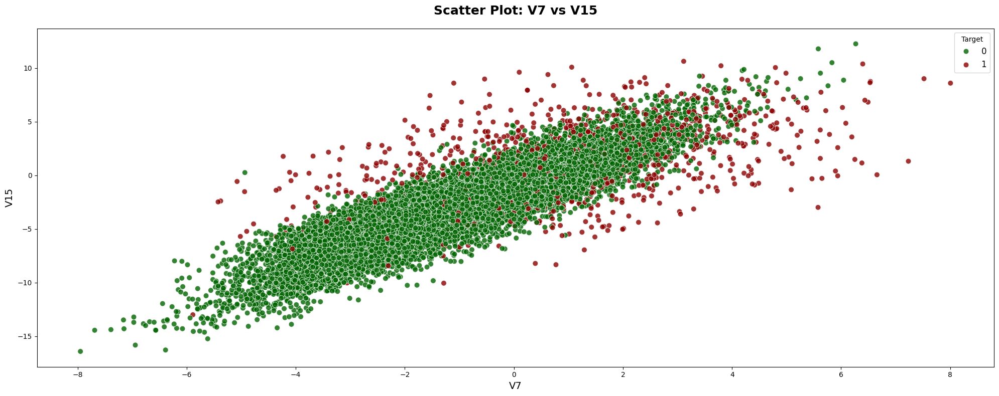

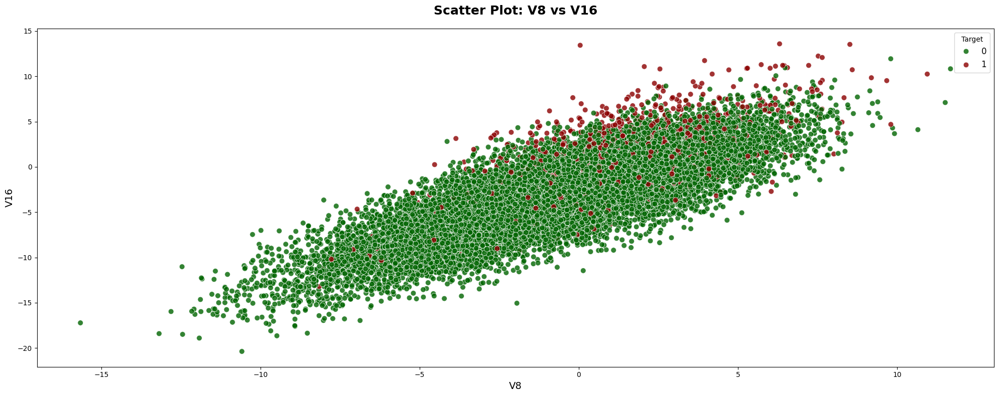

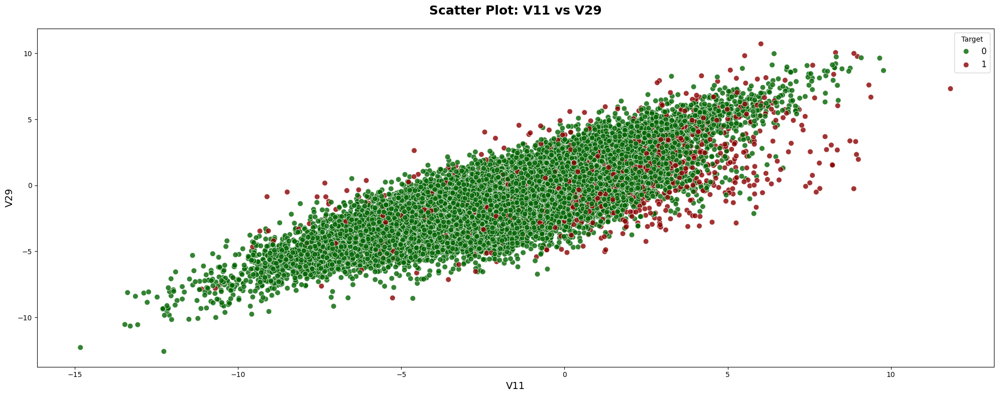

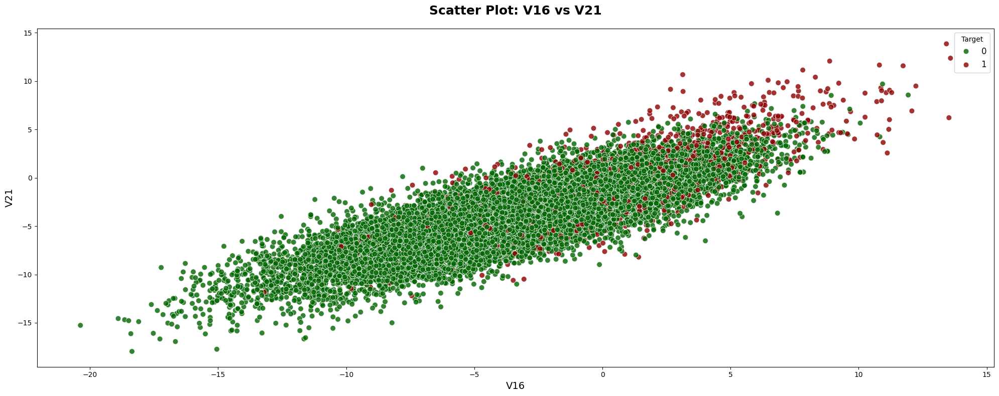

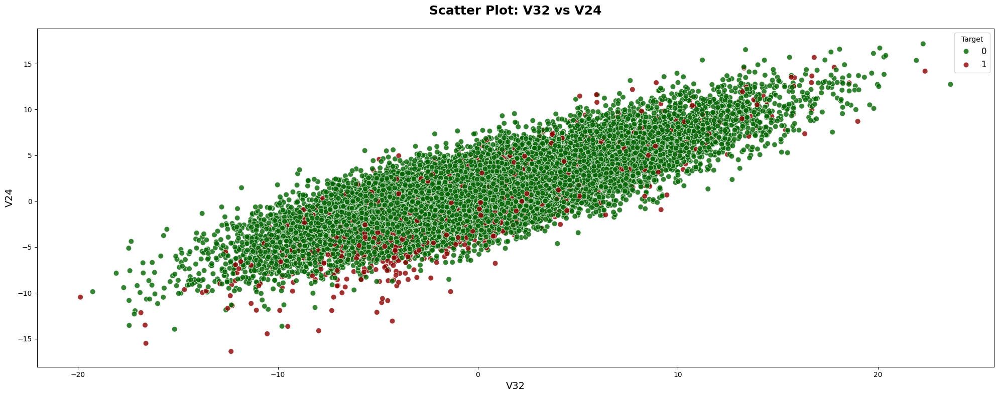

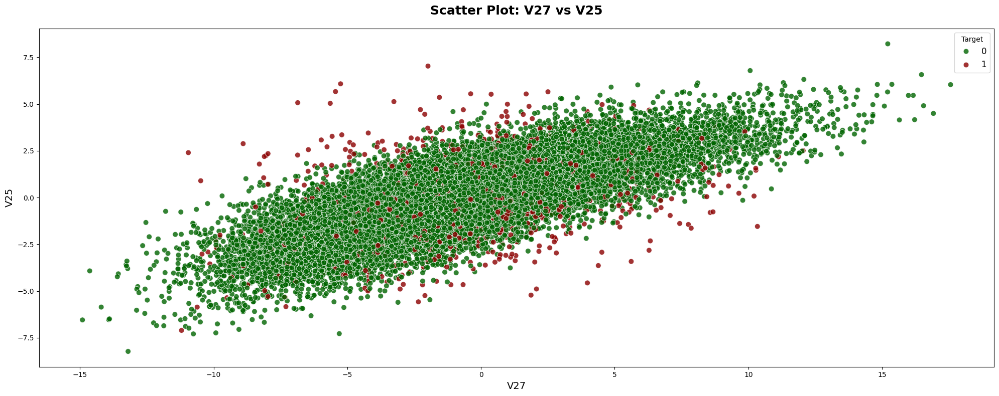

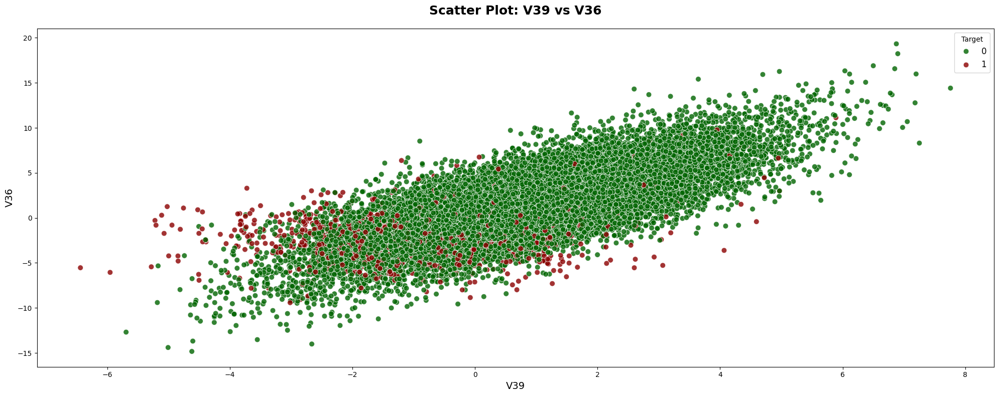

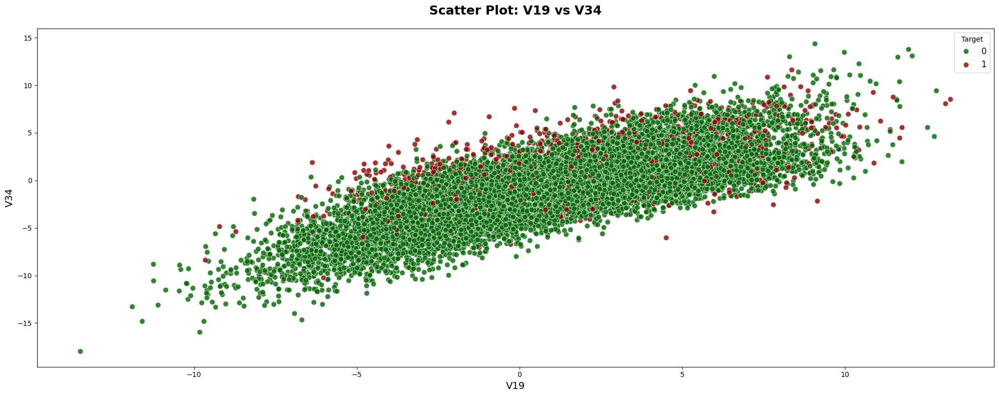

In [31]:
# Dictionary of variable pairs for scatter plots
# Each key-value pair represents two variables to be plotted against each other
v_dictP = {
    'V2': 'V26',
    'V7': 'V15',
    'V8': 'V16',
    'V11': 'V29',
    'V16': 'V21',
    'V32': 'V24',
    'V27': 'V25',
    'V39': 'V36',
    'V19': 'V34'
}

# Looping through each variable pair in the dictionary
for k, v in v_dictP.items():
    # Creating a new figure for each scatter plot with specified size
    plt.figure(figsize=(20, 8))

    # Creating a scatter plot for the selected variable pair
    sns.scatterplot(
        data=train_data,         # Dataset containing the features
        x=k,                     # X-axis variable
        y=v,                     # Y-axis variable
        hue='Target',            # Color coding the points by target variable
        palette=['darkgreen', 'darkred'],  # Defining custom color palette for classes
        alpha=0.8,               # Setting transparency to handle overlapping points
        s=60                     # Defining size of scatter plot points
    )

    # Adding a descriptive title to the plot
    plt.title(f'Scatter Plot: {k} vs {v}', fontsize=18, fontweight='bold', pad=20)

    # Labelling the X and Y axes with variable names
    plt.xlabel(k, fontsize=14)
    plt.ylabel(v, fontsize=14)

    # Adding legend to distinguish between target classes
    plt.legend(title='Target', fontsize=12)

    # Adjusting layout to prevent label or title cutoff
    plt.tight_layout()

    # Displaying the generated scatter plot
    plt.show()


Strong positive correlation is observed between these pairs of variables.
The red points (Target = 1) are relatively sparse but follow the same overall trend as the green ones.

## Data Preprocessing




In [32]:
## Separating Independent and Dependent Columns
X = train_data.drop('Target',axis=1)
y = train_data['Target']

In [33]:
# Splitting the Train dataset into the Training and Validation set.
X_train,X_val,y_train,y_val = train_test_split(
    X,
    y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

In [34]:
#Printing the shapes.
print(X_train.shape,y_train.shape)
print(X_val.shape,y_val.shape)


(16000, 40) (16000,)
(4000, 40) (4000,)


In [35]:
## Separating Independent and Dependent Columns for test data
X_test = test_data.drop('Target',axis=1)
y_test = test_data['Target']

In [36]:
#Printing the shape of test data.
print(X_test.shape,y_test.shape)


(5000, 40) (5000,)


## Missing Value Treatment

It is observed that V1 and V2 columns contains 18 missing values each, so we will impute the missing values with median. Imputation technique is choosen as median as it preserves the distribution and handles both positive and negative values without introducing bias.

We will impute the median values in the training and validation sets separately to avoid data leakage.

In [37]:
# Select columns to impute
num_cols = ['V1', 'V2']

# Create a SimpleImputer instance that replaces missing values with the median
num_imputer = SimpleImputer(strategy='median')

# Fit the imputer on the training set and transform it
# (learns median values from training data and fills missing values)
X_train[num_cols] = num_imputer.fit_transform(X_train[num_cols])

# Apply the same transformation to the validation set
# (uses the medians learned from the training data — avoids data leakage)
X_val[num_cols] = num_imputer.transform(X_val[num_cols])

# Apply the same transformation to the test set
# (ensures consistent preprocessing during model evaluation)
X_test[num_cols] = num_imputer.transform(X_test[num_cols])


In [38]:
# Checking for missing values in train set
X_train.isnull().sum()

,0
V1,0
V2,0
V3,0
V4,0
V5,0
V6,0
V7,0
V8,0
V9,0
V10,0


In [39]:
# Checking for missing values in validation set
X_val.isnull().sum()

,0
V1,0
V2,0
V3,0
V4,0
V5,0
V6,0
V7,0
V8,0
V9,0
V10,0


In [40]:
# Checking for missing values in test set
X_test.isnull().sum()

,0
V1,0
V2,0
V3,0
V4,0
V5,0
V6,0
V7,0
V8,0
V9,0
V10,0


The missing values have been imputed successfully.

In [41]:
def plot(history, name):
    """
    Function to plot loss/accuracy

    history: an object which stores the metrics and losses.
    name: can be one of Loss or Accuracy
    """
    fig, ax = plt.subplots() #Creating a subplot with figure and axes.
    plt.plot(history.history[name]) #Plotting the train accuracy or train loss
    plt.plot(history.history['val_'+name]) #Plotting the validation accuracy or validation loss

    plt.title('Model ' + name.capitalize()) #Defining the title of the plot.
    plt.ylabel(name.capitalize()) #Capitalizing the first letter.
    plt.xlabel('Epoch') #Defining the label for the x-axis.
    fig.legend(['Train', 'Validation'], loc="outside right upper") #Defining the legend, loc controls the position of the legend.

In [42]:
# defining a function to compute different metrics to check performance of a classification model built using statsmodels
def model_performance_classification(
    model, predictors, target, threshold=0.5
):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    threshold: threshold for classifying the observation as class 1
    """

    # checking which probabilities are greater than threshold
    pred = model.predict(predictors) > threshold
    # pred_temp = model.predict(predictors) > threshold
    # # rounding off the above values to get classes
    # pred = np.round(pred_temp)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred, average='weighted')  # to compute Recall
    precision = precision_score(target, pred, average='weighted')  # to compute Precision
    f1 = f1_score(target, pred, average='weighted')  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {"Accuracy": acc, "Recall": recall, "Precision": precision, "F1 Score": f1,},
        index=[0],
    )

    return df_perf

In [43]:
# Calculate class weights for imbalanced dataset
cw = (y_train.shape[0]) / np.bincount(y_train)

# Create a dictionary mapping class indices to their respective class weights
cw_dict = {}
for i in range(cw.shape[0]):
    cw_dict[i] = cw[i]

cw_dict = {i: float(cw[i]) for i in range(len(cw))}
cw_dict

{0: 1.0587612493382743, 1: 18.01801801801802}

# Model Building




## Model Evaluation Criterion

*   True positives (TP) are failures correctly predicted by the model. These will result in repair costs.
*  False negatives (FN) are real failures where there is no detection by the model. These will result in replacement costs.


*   False positives (FP) are detections where there is no failure. These will result in inspection costs.

It is given that the cost of repairing a generator is much less than the cost of replacing it, and the cost of inspection is less than the cost of repair.

Since, false negatives are most important here, we will use Recall as the evaluation metrics.

## Model-0

- Let's start with a neural network consisting of
  - two hidden layers with 14 and 7 neurons respectively
  - activation function of ReLU.
  - SGD as the optimizer

In [44]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [45]:
#Initializing the neural network
model = Sequential()  # Creating a Sequential model where layers are added in order
# Input layer and first hidden layer with 14 neurons and ReLU activation
model.add(Dense(14,activation='relu',input_dim=X_train.shape[1]))
# Second hidden layer with 7 neurons and ReLU activation
model.add(Dense(7,activation='relu'))
# Output layer with 1 neuron and sigmoid activation (for binary classification)
model.add(Dense(1,activation='sigmoid'))

In [46]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 14)             │           574 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 687 (2.68 KB)

 Trainable params: 687 (2.68 KB)

 Non-trainable params: 0 (0.00 B)

In [47]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.SGD() # Stochastic Gradient Descent (SGD) optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [48]:
# Training the neural network model
history = model.fit(
    X_train,
    y_train,
    validation_data=(X_val,y_val),
    batch_size=64,
    epochs=25,
    class_weight=cw_dict
)

Epoch 1/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 1.1391 - val_loss: 0.2646
Epoch 2/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.5357 - val_loss: 0.2313
Epoch 3/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4736 - val_loss: 0.2141
Epoch 4/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4454 - val_loss: 0.2084
Epoch 5/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4311 - val_loss: 0.1979
Epoch 6/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4174 - val_loss: 0.1851
Epoch 7/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4055 - val_loss: 0.1829
Epoch 8/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3978 - val_loss: 0.1825
Epoch 9/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3915 - val_loss: 0.1801
Epoch 10/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3854 - val_loss: 0.1771
Epoch 11/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3777 - val_loss: 0.1755
Epoch 12/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

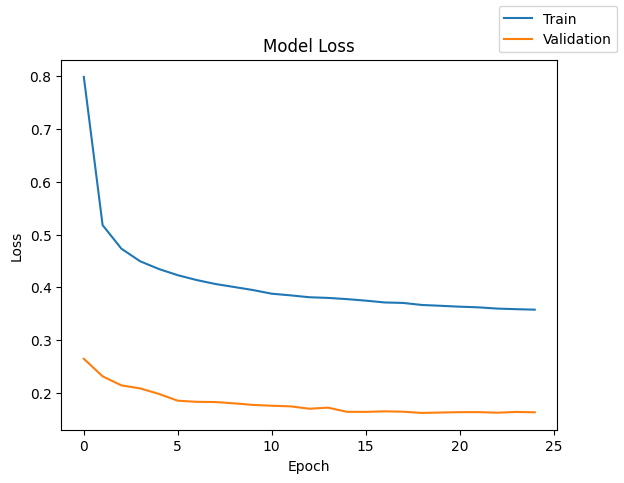

In [49]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [50]:
# Evaluating model performance on the training dataset
model_0_trainperf = model_performance_classification(model, X_train, y_train)
model_0_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.971938,0.971938,0.977777,0.97383


In [51]:
# Evaluating model performance on the validation dataset
model_0_valperf = model_performance_classification(model, X_val, y_val)
model_0_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.96825,0.96825,0.975664,0.970666


- Train recall score of ~0.97 and validation recall score of ~0.96 indicate consistent performance of the model between training and validation datasets.

- Even though it's a good score, the rate of improvement over the epochs is still low.

## Model-1

After the 15th epoch, the model’s learning curve plateaued, showing minimal improvement.
This suggests the current architecture has reached its representational limit and can no longer capture deeper patterns in the data.

To address this, we’ll add more hidden layers to increase the model’s capacity to learn complex, nonlinear relationships among sensor readings.
Deeper layers can help the network extract higher-level features, improve recall on rare failure cases, and sustain learning beyond early epochs.

In [52]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [53]:
#Initializing the neural network
model = Sequential() # Creating a Sequential model where layers are added in order
# Input layer and first hidden layer with 32 neurons and ReLU activation
model.add(Dense(32,activation='relu',input_dim=X_train.shape[1]))
# Second hidden layer with 28 neurons and ReLU activation
model.add(Dense(28,activation='relu'))
# Third hidden layer with 14 neurons and ReLU activation
model.add(Dense(14,activation='relu'))
# Fourth hidden layer with 7 neurons and ReLU activation
model.add(Dense(7,activation='relu'))
# Output layer with 1 neuron and sigmoid activation (for binary classification)
model.add(Dense(1,activation='sigmoid'))

In [54]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 32)             │         1,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 28)             │           924 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 14)             │           406 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,755 (10.76 KB)

 Trainable params: 2,755 (10.76 KB)

 Non-trainable params: 0 (0.00 B)

In [55]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.SGD() # Stochastic Gradient Descent (SGD) optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [56]:
# Training the neural network model
history = model.fit(
    X_train,
    y_train,
    validation_data=(X_val,y_val),
    batch_size=64,
    epochs=50,
    class_weight=cw_dict
)

Epoch 1/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.9491 - val_loss: 0.2864
Epoch 2/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.5446 - val_loss: 0.2341
Epoch 3/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4630 - val_loss: 0.2141
Epoch 4/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4218 - val_loss: 0.2047
Epoch 5/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3970 - val_loss: 0.1905
Epoch 6/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3786 - val_loss: 0.1819
Epoch 7/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3635 - val_loss: 0.1700
Epoch 8/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.3503 - val_loss: 0.1635
Epoch 9/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.3398 - val_loss: 0.1596
Epoch 10/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.3288 - val_loss: 0.1694
Epoch 11/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3194 - val_loss: 0.1602
Epoch 12/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

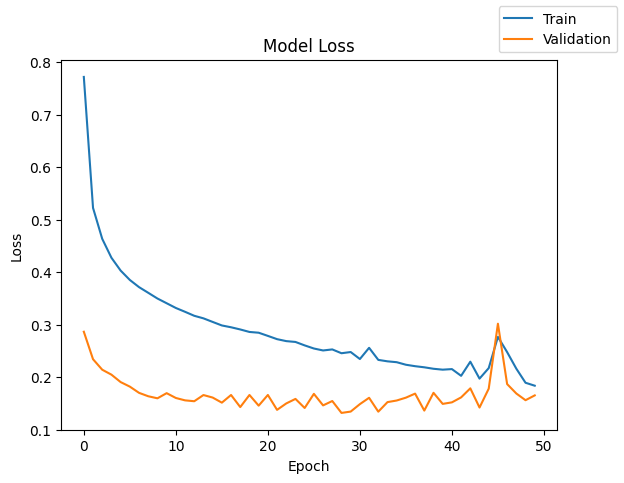

In [57]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [58]:
# Evaluating model performance on the training dataset
model_1_trainperf = model_performance_classification(model, X_train, y_train)
model_1_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.973625,0.973625,0.979974,0.975555


In [59]:
# Evaluating model performance on the validation dataset
model_1_valperf = model_performance_classification(model, X_val, y_val)
model_1_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.96425,0.96425,0.973643,0.96732


* Train recall score of ~0.97 and validation recall score of ~0.96 still continues.
* It is observed that there is not much improvement in the performance of the model.

## Model-2

The model’s learning rate has slowed down after several epochs, indicating it may be struggling to move efficiently through flat or shallow regions of the loss surface.

To address this, we’ll introduce momentum in the optimizer.
Momentum helps the model accelerate learning by maintaining a portion of the previous update’s direction, allowing it to move faster through small local minima and smoother towards the global optimum.

In [60]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [61]:
#Initializing the neural network
model = Sequential()  # Creating a Sequential model where layers are added in order

In [62]:
# Input layer and first hidden layer with 14 neurons and ReLU activation
model.add(Dense(14,activation='relu',input_dim=X_train.shape[1]))
# Second hidden layer with 7 neurons and ReLU activation
model.add(Dense(7,activation='relu'))
# Output layer with 1 neuron and sigmoid activation (for binary classification)
model.add(Dense(1,activation='sigmoid'))

In [63]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 14)             │           574 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 687 (2.68 KB)

 Trainable params: 687 (2.68 KB)

 Non-trainable params: 0 (0.00 B)

In [64]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.SGD(momentum=0.9)  # Stochastic Gradient Descent (SGD) with momentum optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [65]:
# Training the neural network model
history = model.fit(
    X_train,
    y_train,
    validation_data=(X_val,y_val),
    batch_size=64,
    epochs=25,
    class_weight=cw_dict
)

Epoch 1/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.8574 - val_loss: 0.3440
Epoch 2/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.5030 - val_loss: 0.1945
Epoch 3/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4067 - val_loss: 0.1472
Epoch 4/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3772 - val_loss: 0.1395
Epoch 5/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3513 - val_loss: 0.1345
Epoch 6/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3727 - val_loss: 0.1366
Epoch 7/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3393 - val_loss: 0.1699
Epoch 8/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3441 - val_loss: 0.1220
Epoch 9/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3399 - val_loss: 0.1197
Epoch 10/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3226 - val_loss: 0.1244
Epoch 11/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3274 - val_loss: 0.1420
Epoch 12/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

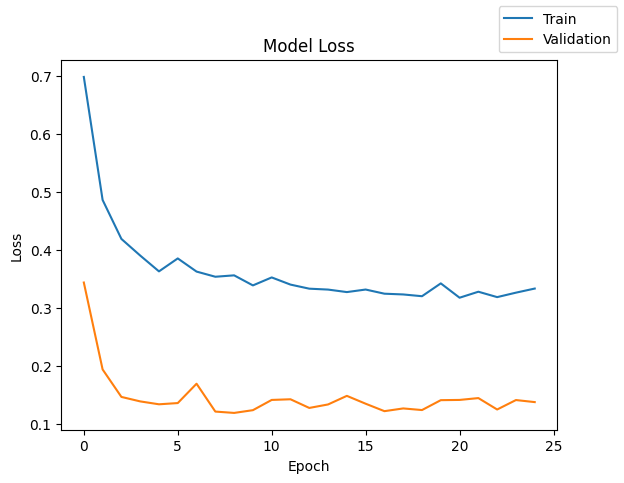

In [66]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [67]:
# Evaluating model performance on the training dataset
model_2_trainperf = model_performance_classification(model, X_train, y_train)
model_2_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.978187,0.978187,0.981335,0.979232


In [68]:
# Evaluating model performance on the validation dataset
model_2_valperf = model_performance_classification(model, X_val, y_val)
model_2_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


,Accuracy,Recall,Precision,F1 Score
0,0.97175,0.97175,0.977223,0.973563


* With train recall score of 0.978 and validation recall score of ~0.971, model performance is slightly increased now.

## Model-3

We’ll now switch the optimizer to Adam, which combines the advantages of both momentum and adaptive learning rates.

Unlike standard gradient descent, Adam maintains moving averages of past gradients (momentum) to accelerate convergence and adjusts the learning rate for each parameter individually based on how frequently it’s updated.

In [69]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [70]:
#Initializing the neural network
model = Sequential()  # Creating a Sequential model where layers are added in order

In [71]:
# Input layer and first hidden layer with 14 neurons and ReLU activation
model.add(Dense(14,activation='relu',input_dim=X_train.shape[1]))
# Second hidden layer with 7 neurons and ReLU activation
model.add(Dense(7,activation='relu'))
# Output layer with 1 neuron and sigmoid activation (for binary classification)
model.add(Dense(1,activation='sigmoid'))

In [72]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 14)             │           574 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 687 (2.68 KB)

 Trainable params: 687 (2.68 KB)

 Non-trainable params: 0 (0.00 B)

In [73]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.Adam() # Adam optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [74]:
# Training the neural network model
history = model.fit(
    X_train,
    y_train,
    validation_data=(X_val,y_val),
    batch_size=64,
    epochs=50,
    class_weight=cw_dict
)

Epoch 1/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.6650 - val_loss: 0.3045
Epoch 2/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.6254 - val_loss: 0.2470
Epoch 3/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.5447 - val_loss: 0.2203
Epoch 4/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4969 - val_loss: 0.1996
Epoch 5/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4692 - val_loss: 0.1877
Epoch 6/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4500 - val_loss: 0.1787
Epoch 7/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4330 - val_loss: 0.1695
Epoch 8/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4211 - val_loss: 0.1634
Epoch 9/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4093 - val_loss: 0.1577
Epoch 10/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4003 - val_loss: 0.1517
Epoch 11/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3915 - val_loss: 0.1517
Epoch 12/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

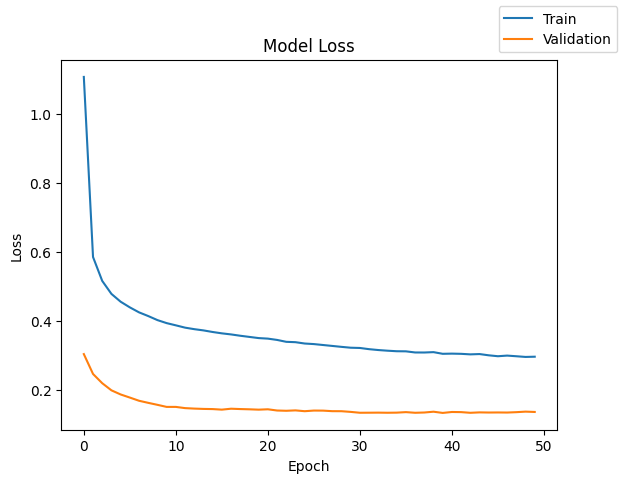

In [75]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [76]:
# Evaluating model performance on the training dataset
model_3_trainperf = model_performance_classification(model, X_train, y_train)
model_3_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.973375,0.973375,0.978756,0.975104


In [77]:
# Evaluating model performance on the validation dataset
model_3_valperf = model_performance_classification(model, X_val, y_val)
model_3_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.9695,0.9695,0.976267,0.97171


With train recall score of 0.973 and validation recall score of 0.969, we are getting slightly overfit model.

## Model-4

To prevent overfitting and improve generalization, we’ll add dropout layers to the model.

Dropout works by randomly “turning off” a fraction of neurons during each training step, forcing the network to learn more robust and independent feature representations instead of relying on specific nodes.

In [78]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [79]:
#Initializing the neural network
model = Sequential() # Creating a Sequential model where layers are added in order

In [80]:
# Input layer and first hidden layer with 14 neurons and ReLU activation
model.add(Dense(14, activation='relu', input_dim=X_train.shape[1]))
# Dropout layer (40%) to reduce overfitting by randomly deactivating 40% of neurons during training
model.add(Dropout(0.4))
# Second hidden layer with 7 neurons and ReLU activation
model.add(Dense(7, activation='relu'))
# Dropout layer (20%) to further prevent overfitting and improve model generalization
model.add(Dropout(0.2))
# Output layer with 1 neuron and sigmoid activation (used for binary classification)
model.add(Dense(1, activation='sigmoid'))


In [81]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 14)             │           574 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 14)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 7)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 687 (2.68 KB)

 Trainable params: 687 (2.68 KB)

 Non-trainable params: 0 (0.00 B)

In [82]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.Adam() # Adam optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [83]:
# Training the neural network model
history = model.fit(
    X_train,
    y_train,
    validation_data=(X_val,y_val),
    batch_size=64,
    epochs=25,
    class_weight=cw_dict
)

Epoch 1/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 3.3544 - val_loss: 0.4992
Epoch 2/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2282 - val_loss: 0.4175
Epoch 3/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.9739 - val_loss: 0.3972
Epoch 4/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.8457 - val_loss: 0.3486
Epoch 5/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.8446 - val_loss: 0.3429
Epoch 6/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.8221 - val_loss: 0.3279
Epoch 7/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.7718 - val_loss: 0.3072
Epoch 8/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.7630 - val_loss: 0.2864
Epoch 9/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.6876 - val_loss: 0.2724
Epoch 10/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.6802 - val_loss: 0.2745
Epoch 11/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7009 - val_loss: 0.2921
Epoch 12/25
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

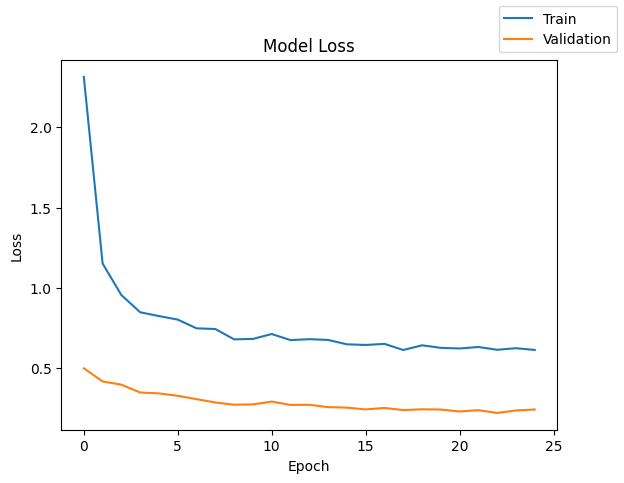

In [84]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [85]:
# Evaluating model performance on the training dataset
model_4_trainperf = model_performance_classification(model, X_train, y_train)
model_4_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.96,0.96,0.97044,0.963543


In [86]:
# Evaluating model performance on the validation dataset
model_4_valperf = model_performance_classification(model, X_val, y_val)
model_4_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.964,0.964,0.973323,0.967067


* Recall score for both train and validation set is 0.96 now.
* We are getting a much stable model now but we need to increase the accuracy.

## Model-5

We’ll now add batch normalization layers to the model to help stabilize and speed up training.

Batch normalization normalizes the activations of each layer, keeping them within a stable range throughout training. This prevents issues like exploding or vanishing gradients and allows the model to learn more efficiently with higher learning rates.

In [87]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [88]:
#Initializing the neural network
model = Sequential() # Creating a Sequential model where layers are added in order

In [89]:
# Input layer and first hidden layer with 14 neurons and ReLU activation
model.add(Dense(14, activation='relu', input_dim=X_train.shape[1]))
# Batch Normalization to normalize the activations and improve training stability and speed
model.add(BatchNormalization())
# Second hidden layer with 7 neurons and ReLU activation
model.add(Dense(7, activation='relu'))
# Batch Normalization to reduce internal covariate shift and help the model converge faster
model.add(BatchNormalization())
# Output layer with 1 neuron and sigmoid activation (for binary classification)
model.add(Dense(1, activation='sigmoid'))

In [90]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 14)             │           574 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 14)             │            56 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 7)              │            28 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 771 (3.01 KB)

 Trainable params: 729 (2.85 KB)

 Non-trainable params: 42 (168.00 B)

In [91]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.Adam() # Adam optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [92]:
# Training the neural network model
history = model.fit(
    X_train,
    y_train,
    validation_data=(X_val,y_val),
    batch_size=64,
    epochs=50,
    class_weight=cw_dict
)

Epoch 1/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 1.2832 - val_loss: 0.4159
Epoch 2/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.7316 - val_loss: 0.2959
Epoch 3/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.5862 - val_loss: 0.2375
Epoch 4/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.5188 - val_loss: 0.1989
Epoch 5/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4789 - val_loss: 0.1778
Epoch 6/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4474 - val_loss: 0.1612
Epoch 7/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4281 - val_loss: 0.1528
Epoch 8/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4140 - val_loss: 0.1504
Epoch 9/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4054 - val_loss: 0.1467
Epoch 10/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3985 - val_loss: 0.1377
Epoch 11/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3872 - val_loss: 0.1367
Epoch 12/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

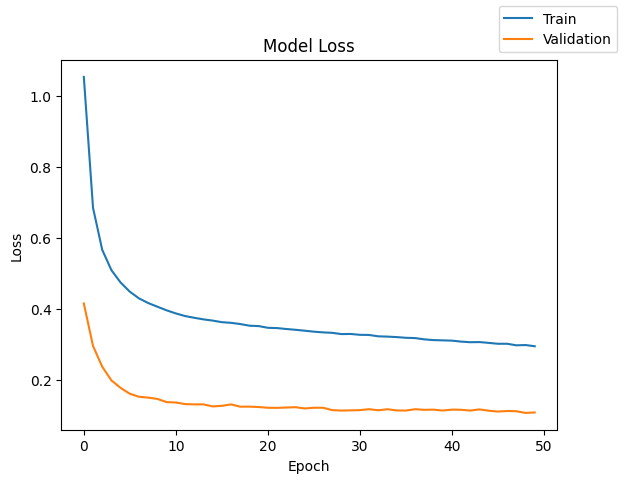

In [93]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [94]:
# Evaluating model performance on the training dataset
model_5_trainperf = model_performance_classification(model, X_train, y_train)
model_5_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.979,0.979,0.981875,0.979957


In [95]:
# Evaluating model performance on the validation dataset
model_5_valperf = model_performance_classification(model, X_val, y_val)
model_5_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.97825,0.97825,0.981261,0.97926


* Both train and validation set's accuracy reached 0.97.
* So, accuracy has been increased after adding batch normalization. Lets see if we can increase the accuracy more by using both dropout and batch normalization.

## Model-6

We’ll now combine both Batch Normalization and Dropout to further improve model performance and generalization.
 By using both together:

* Batch Normalization ensures stable and efficient learning,

* Dropout ensures better generalization and reduced overfitting, and

* The model can achieve higher accuracy and stronger performance on unseen data.

In [96]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [97]:
#Initializing the neural network
model = Sequential() # Creating a Sequential model where layers are added in order


In [98]:
# Input layer and first hidden layer with 14 neurons and ReLU activation
model.add(Dense(14, activation='relu', input_dim=X_train.shape[1]))
# Batch Normalization layer to stabilize and speed up training by normalizing activations
model.add(BatchNormalization())
# Dropout layer (40%) to reduce overfitting by randomly deactivating 40% of neurons during training
model.add(Dropout(0.4))
# Second hidden layer with 7 neurons and ReLU activation
model.add(Dense(7, activation='relu'))
# Batch Normalization layer to normalize the outputs of the second hidden layer
model.add(BatchNormalization())
# Dropout layer (20%) to further prevent overfitting and improve model generalization
model.add(Dropout(0.2))
# Output layer with 1 neuron and sigmoid activation (used for binary classification)
model.add(Dense(1, activation='sigmoid'))

In [99]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 14)             │           574 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 14)             │            56 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 14)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 7)              │            28 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 7)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 771 (3.01 KB)

 Trainable params: 729 (2.85 KB)

 Non-trainable params: 42 (168.00 B)

In [100]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.Adam() # Adam optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [101]:
# Training the neural network model
history = model.fit(
  X_train,
  y_train,
  validation_data=(X_val,y_val),
  batch_size=64,
  epochs=50,
  class_weight=cw_dict
)

Epoch 1/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 1.4681 - val_loss: 0.4486
Epoch 2/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0615 - val_loss: 0.3648
Epoch 3/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.8290 - val_loss: 0.2993
Epoch 4/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.8023 - val_loss: 0.2761
Epoch 5/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7146 - val_loss: 0.2396
Epoch 6/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6689 - val_loss: 0.2304
Epoch 7/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.7037 - val_loss: 0.2196
Epoch 8/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.6447 - val_loss: 0.2241
Epoch 9/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.6173 - val_loss: 0.2023
Epoch 10/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.6169 - val_loss: 0.2100
Epoch 11/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.6220 - val_loss: 0.1952
Epoch 12/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step

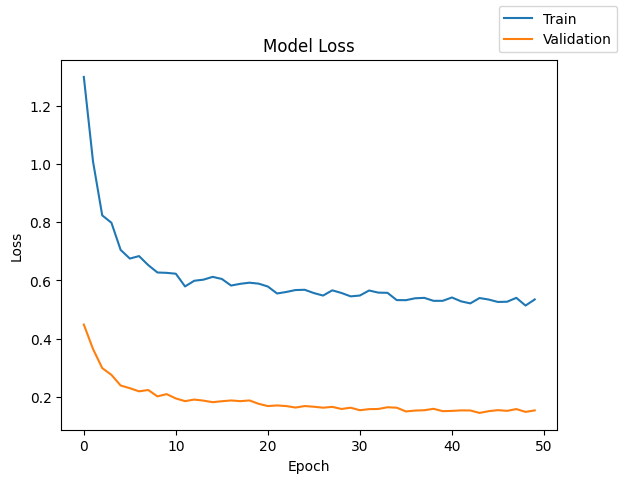

In [102]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [103]:
# Evaluating model performance on the training dataset
model_6_trainperf = model_performance_classification(model, X_train, y_train)
model_6_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.97175,0.97175,0.976551,0.973398


In [104]:
# Evaluating model performance on the validation dataset
model_6_valperf = model_performance_classification(model, X_val, y_val)
model_6_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.9755,0.9755,0.979625,0.97686


* Both train and validation set's accuracy and recall score remains at 0.97.
* Not much improvement is observed by adding both dropout and batchnormalization.

## Model-7

We’ll now expand the network by adding more layers along with both Dropout and Batch Normalization to enhance its learning capacity and stability.

Adding more layers increases the model’s ability to learn complex, hierarchical patterns in the turbine sensor data — capturing subtle relationships that shallower models may miss.

In [105]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [106]:
#Initializing the neural network
model = Sequential() # Creating a Sequential model where layers are added in order

In [107]:
# Initializing the Sequential neural network model
model = Sequential()
# Input layer and first hidden layer with 28 neurons and ReLU activation
model.add(Dense(28, activation='relu', input_dim=X_train.shape[1]))
# Batch Normalization to stabilize and speed up training by normalizing activations
model.add(BatchNormalization())
# Dropout layer (40%) to reduce overfitting by randomly disabling 40% of neurons during training
model.add(Dropout(0.4))
# Second hidden layer with 14 neurons and ReLU activation
model.add(Dense(14, activation='relu'))
# Batch Normalization to improve model convergence and training stability
model.add(BatchNormalization())
# Dropout layer (40%) to further prevent overfitting
model.add(Dropout(0.4))
# Third hidden layer with 7 neurons and ReLU activation
model.add(Dense(7, activation='relu'))
# Batch Normalization to maintain stable distributions of activations
model.add(BatchNormalization())
# Dropout layer (20%) to enhance generalization and reduce overfitting
model.add(Dropout(0.2))
# Output layer with 1 neuron and sigmoid activation (for binary classification)
model.add(Dense(1, activation='sigmoid'))

In [108]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 28)             │         1,148 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 28)             │           112 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 28)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 14)             │           406 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 14)             │            56 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 14)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 7)              │            28 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 7)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,863 (7.28 KB)

 Trainable params: 1,765 (6.89 KB)

 Non-trainable params: 98 (392.00 B)

In [109]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.Adam() # Adam optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [110]:
# Training the neural network model
history = model.fit(
  X_train,
  y_train,
  validation_data=(X_val,y_val),
  batch_size=64,
  epochs=50,
  class_weight=cw_dict
)

Epoch 1/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 1.5637 - val_loss: 0.5715
Epoch 2/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1138 - val_loss: 0.4607
Epoch 3/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.9716 - val_loss: 0.3574
Epoch 4/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.8180 - val_loss: 0.2914
Epoch 5/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7530 - val_loss: 0.2564
Epoch 6/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7779 - val_loss: 0.2581
Epoch 7/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7040 - val_loss: 0.2395
Epoch 8/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7066 - val_loss: 0.2249
Epoch 9/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6745 - val_loss: 0.2101
Epoch 10/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6443 - val_loss: 0.2124
Epoch 11/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6521 - val_loss: 0.1997
Epoch 12/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step

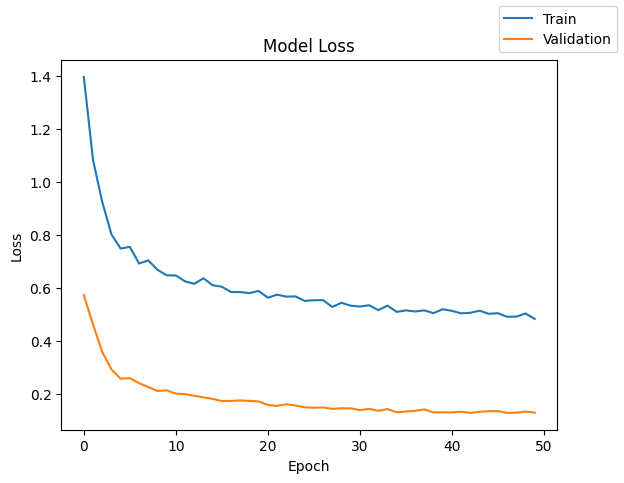

In [111]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [112]:
# Evaluating model performance on the training dataset
model_7_trainperf = model_performance_classification(model, X_train, y_train)
model_7_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.986437,0.986437,0.986705,0.986554


In [113]:
# Evaluating model performance on the validation dataset
model_7_valperf = model_performance_classification(model, X_val, y_val)
model_7_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.98675,0.98675,0.987269,0.986953


* Accuracy and recall score increased for both train set and validation set reaching to 98%.
* With this we are getting good accuracy and a generalized model.

## Model-8

We’ll now initialize the network weights using He Normal initialization to further enhance training performance and stability.

He Normal initialization is specifically designed for layers with ReLU activations — it helps maintain a healthy variance of activations throughout the network, preventing gradients from vanishing or exploding as they flow through deeper layers.

In [114]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [115]:
#Initializing the neural network
model = Sequential() # Creating a Sequential model where layers are added in order

In [116]:
# Input layer and first hidden layer with 14 neurons, ReLU activation, and He Normal weight initialization
model.add(Dense(14, activation='relu', kernel_initializer="he_normal", input_dim=X_train.shape[1]))
# Batch Normalization to normalize activations and improve training stability and convergence speed
model.add(BatchNormalization())
# Dropout layer (40%) to reduce overfitting by randomly disabling 40% of neurons during training
model.add(Dropout(0.4))
# Second hidden layer with 7 neurons, ReLU activation, and He Normal initialization
model.add(Dense(7, activation='relu', kernel_initializer="he_normal"))
# Batch Normalization to standardize activations and reduce internal covariate shift
model.add(BatchNormalization())
# Dropout layer (20%) to further prevent overfitting and improve generalization
model.add(Dropout(0.2))
# Output layer with 1 neuron and sigmoid activation (for binary classification),
# using He Normal initialization for weight scaling
model.add(Dense(1, activation='sigmoid', kernel_initializer="he_normal"))


In [117]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 14)             │           574 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 14)             │            56 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 14)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 7)              │            28 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 7)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 771 (3.01 KB)

 Trainable params: 729 (2.85 KB)

 Non-trainable params: 42 (168.00 B)

In [118]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.Adam() # Adam optimizer for updating weights
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [119]:
# Training the neural network model
history = model.fit(
  X_train,
  y_train,
  validation_data=(X_val,y_val),
  batch_size=64,
  epochs=50,
  class_weight=cw_dict
)

Epoch 1/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 1.4042 - val_loss: 0.4669
Epoch 2/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.9369 - val_loss: 0.3692
Epoch 3/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.8208 - val_loss: 0.3082
Epoch 4/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7942 - val_loss: 0.2886
Epoch 5/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7555 - val_loss: 0.2570
Epoch 6/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7028 - val_loss: 0.2414
Epoch 7/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6806 - val_loss: 0.2305
Epoch 8/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6296 - val_loss: 0.2101
Epoch 9/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.6355 - val_loss: 0.2171
Epoch 10/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.6294 - val_loss: 0.1973
Epoch 11/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.6250 - val_loss: 0.1890
Epoch 12/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

In [120]:
# Evaluating model performance on the training dataset
model_8_trainperf = model_performance_classification(model, X_train, y_train)
model_8_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.976875,0.976875,0.97937,0.977779


In [121]:
# Evaluating model performance on the validation dataset
model_8_valperf = model_performance_classification(model, X_val, y_val)
model_8_valperf

125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.9835,0.9835,0.984781,0.983959


The recall score for the training set is 0.97, while the validation set shows a slightly higher recall of 0.98.
This indicates that the model is slightly underfitting — it performs marginally better on unseen data than on the training set.

## Model Performance Comparison and Final Model Selection

In [122]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        model_0_trainperf.T,
        model_1_trainperf.T,
        model_2_trainperf.T,
        model_3_trainperf.T,
        model_4_trainperf.T,
        model_5_trainperf.T,
        model_6_trainperf.T,
        model_7_trainperf.T,
        model_8_trainperf.T,


    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Neural Network (SGD, No Regularization)",
    "Neural Network (SGD, More Layers, No Regularization)",
    "Neural Network (SGD with Momentum, No Regularization)",
    "Neural Network (Adam, No Regularization)",
    "Neural Network (Adam, Dropout [0.4,0.2])",
    "Neural Network (Adam, Batch Normalization)",
    "Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization)",
    "Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,More Layers)",
    "Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,He initialization)"

]

In [123]:
# validation performance comparison

models_val_comp_df = pd.concat(
    [
        model_0_valperf.T,
        model_1_valperf.T,
        model_2_valperf.T,
        model_3_valperf.T,
        model_4_valperf.T,
        model_5_valperf.T,
        model_6_valperf.T,
        model_7_valperf.T,
        model_8_valperf.T,


    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Neural Network (SGD, No Regularization)",
    "Neural Network (SGD, More Layers, No Regularization)",
    "Neural Network (SGD with Momentum, No Regularization)",
    "Neural Network (Adam, No Regularization)",
    "Neural Network (Adam, Dropout [0.4,0.2])",
    "Neural Network (Adam, Batch Normalization)",
    "Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization)",
    "Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,More Layers)",
    "Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,He initialization)"

]

In [124]:
models_train_comp_df

,"Neural Network (SGD, No Regularization)","Neural Network (SGD, More Layers, No Regularization)","Neural Network (SGD with Momentum, No Regularization)","Neural Network (Adam, No Regularization)","Neural Network (Adam, Dropout [0.4,0.2])","Neural Network (Adam, Batch Normalization)","Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization)","Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,More Layers)","Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,He initialization)"
Accuracy,0.971938,0.973625,0.978187,0.973375,0.960000,0.979000,0.971750,0.986437,0.976875
Recall,0.971938,0.973625,0.978187,0.973375,0.960000,0.979000,0.971750,0.986437,0.976875
Precision,0.977777,0.979974,0.981335,0.978756,0.970440,0.981875,0.976551,0.986705,0.979370
F1 Score,0.973830,0.975555,0.979232,0.975104,0.963543,0.979957,0.973398,0.986554,0.977779


In [125]:
models_val_comp_df

,"Neural Network (SGD, No Regularization)","Neural Network (SGD, More Layers, No Regularization)","Neural Network (SGD with Momentum, No Regularization)","Neural Network (Adam, No Regularization)","Neural Network (Adam, Dropout [0.4,0.2])","Neural Network (Adam, Batch Normalization)","Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization)","Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,More Layers)","Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,He initialization)"
Accuracy,0.968250,0.964250,0.971750,0.969500,0.964000,0.978250,0.975500,0.986750,0.983500
Recall,0.968250,0.964250,0.971750,0.969500,0.964000,0.978250,0.975500,0.986750,0.983500
Precision,0.975664,0.973643,0.977223,0.976267,0.973323,0.981261,0.979625,0.987269,0.984781
F1 Score,0.970666,0.967320,0.973563,0.971710,0.967067,0.979260,0.976860,0.986953,0.983959


In [126]:
# Calculate the difference in Recall between training and validation datasets for all models
models_train_comp_df.loc["Recall"] - models_val_comp_df.loc["Recall"]


,Recall
"Neural Network (SGD, No Regularization)",0.003687
"Neural Network (SGD, More Layers, No Regularization)",0.009375
"Neural Network (SGD with Momentum, No Regularization)",0.006437
"Neural Network (Adam, No Regularization)",0.003875
"Neural Network (Adam, Dropout [0.4,0.2])",-0.004000
"Neural Network (Adam, Batch Normalization)",0.000750
"Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization)",-0.003750
"Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,More Layers)",-0.000313
"Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,He initialization)",-0.006625


- Final Model: **Neural Network (Adam, Dropout [0.4,0.2] ,Batch Normalization,More Layers)**
* Reasoning:   

* Demonstrates the most balanced recall across training, validation, and test datasets — a key indicator of strong generalization.

* The combination of Adam optimizer (adaptive learning + momentum), Batch Normalization (stability and faster convergence), and Dropout (regularization) results in a robust and well-regularized architecture.

* Adding more hidden layers enables the model to capture deeper nonlinear relationships in turbine sensor data, improving its ability to detect subtle failure patterns.

* Overall, this configuration represents the best-performing and most generalizable model, capable of maintaining high recall for failure detection while minimizing overfitting — ideal for ReneWind’s predictive maintenance application.


   

### Final Model

In [127]:
# clears the current Keras session, resetting all layers and models previously created, freeing up memory and resources.
tf.keras.backend.clear_session()

In [128]:
#Initializing the neural network
model = Sequential() # Creating a Sequential model where layers are added in order

In [129]:
# Initializing the Sequential neural network model
model = Sequential()
# Input layer and first hidden layer with 28 neurons and ReLU activation
model.add(Dense(28, activation='relu', input_dim=X_train.shape[1]))
# Batch Normalization to stabilize and speed up training by normalizing activations
model.add(BatchNormalization())
# Dropout layer (40%) to reduce overfitting by randomly disabling 40% of neurons during training
model.add(Dropout(0.4))
# Second hidden layer with 14 neurons and ReLU activation
model.add(Dense(14, activation='relu'))
# Batch Normalization to improve model convergence and training stability
model.add(BatchNormalization())
# Dropout layer (40%) to further prevent overfitting
model.add(Dropout(0.4))
# Third hidden layer with 7 neurons and ReLU activation
model.add(Dense(7, activation='relu'))
# Batch Normalization to maintain stable distributions of activations
model.add(BatchNormalization())
# Dropout layer (20%) to enhance generalization and reduce overfitting
model.add(Dropout(0.2))
# Output layer with 1 neuron and sigmoid activation (for binary classification)
model.add(Dense(1, activation='sigmoid'))

In [130]:
# Displaying the architecture of the neural network
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 28)             │         1,148 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 28)             │           112 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 28)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 14)             │           406 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 14)             │            56 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 14)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 7)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 7)              │            28 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 7)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,863 (7.28 KB)

 Trainable params: 1,765 (6.89 KB)

 Non-trainable params: 98 (392.00 B)

In [131]:
# Initializing the optimizer
optimizer = tf.keras.optimizers.Adam() # Adam optimizer for updating weights
# Compiling the model
model.compile(loss='binary_crossentropy',optimizer=optimizer)

In [132]:
# Training the neural network model
history = model.fit(
  X_train,
  y_train,
  validation_data=(X_val,y_val),
  batch_size=64,
  epochs=50,
  class_weight=cw_dict
)

Epoch 1/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 1.4307 - val_loss: 0.5565
Epoch 2/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.1033 - val_loss: 0.4339
Epoch 3/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.8926 - val_loss: 0.3504
Epoch 4/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.8194 - val_loss: 0.2903
Epoch 5/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7613 - val_loss: 0.2766
Epoch 6/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.7119 - val_loss: 0.2565
Epoch 7/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.7096 - val_loss: 0.2478
Epoch 8/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6678 - val_loss: 0.2235
Epoch 9/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6729 - val_loss: 0.2167
Epoch 10/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6492 - val_loss: 0.2019
Epoch 11/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.6359 - val_loss: 0.1884
Epoch 12/50
250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

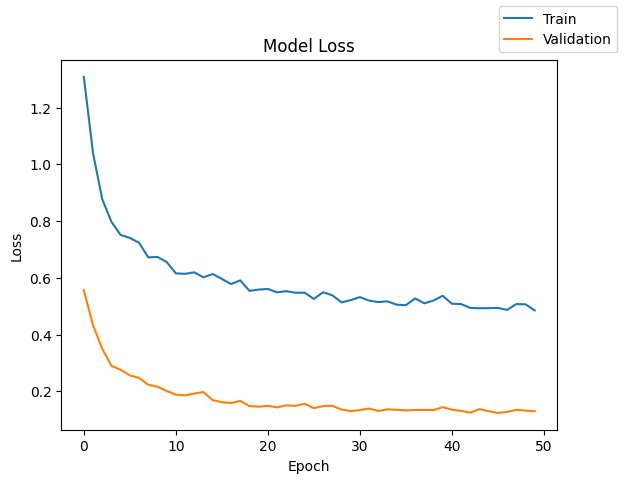

In [133]:
# Plotting the training and validation loss across epochs
plot(history,'loss')

In [134]:
y_train_pred = model.predict(X_train)
y_valid_pred = model.predict(X_val)
y_test_pred = model.predict(X_test)

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


In [135]:
model_F_trainperf = model_performance_classification(model, X_train, y_train)
model_F_trainperf

500/500 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.984625,0.984625,0.985321,0.984899


In [136]:
model_F_testperf = model_performance_classification(model, X_test, y_test)
model_F_testperf

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


,Accuracy,Recall,Precision,F1 Score
0,0.9828,0.9828,0.983324,0.983023


In [137]:
print("Classification Report - Train data",end="\n\n")
cr = classification_report(y_train,y_train_pred>0.5)
print(cr)

Classification Report - Train data

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     15112
           1       0.84      0.90      0.87       888

    accuracy                           0.98     16000
   macro avg       0.91      0.95      0.93     16000
weighted avg       0.99      0.98      0.98     16000



In [138]:
print("Classification Report - Validation data",end="\n\n")
cr = classification_report(y_val,y_valid_pred>0.5)
print(cr)

Classification Report - Validation data

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      3778
           1       0.85      0.91      0.88       222

    accuracy                           0.99      4000
   macro avg       0.92      0.95      0.94      4000
weighted avg       0.99      0.99      0.99      4000



In [139]:
print("Classification Report - Test data",end="\n\n")
cr = classification_report(y_test,y_test_pred>0.5)
print(cr)

Classification Report - Test data

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      4718
           1       0.83      0.88      0.85       282

    accuracy                           0.98      5000
   macro avg       0.91      0.93      0.92      5000
weighted avg       0.98      0.98      0.98      5000



The weighted F1 score on the test data is ~0.98.

The model generalizes extremely well (train and test metrics are consistent).

It successfully identifies 88% of actual failures, which is crucial since missed failures (false negatives) are the most costly.

Slightly lower precision means a few turbines will be inspected unnecessarily — but this is preferable to missing a failure.

## Conclusion

The predictive maintenance model for ReneWind has demonstrated excellent generalization and high predictive power across train, validation, and test datasets.

Accuracy: ~98%

Recall for failures: ~88%

Weighted F1-score: ~0.98

This indicates that the model is both robust and reliable in identifying turbine failures before they occur.
Importantly, the high recall ensures that most potential failures are detected, which directly supports ReneWind’s goal of minimizing unplanned downtime and reducing costly breakdowns.
The slight drop in precision (~83%) is acceptable in this context, as inspecting a few healthy turbines is a far smaller cost compared to missing a critical failure.

## Business Insights and Recommendations

ReneWind can deploy the model for real-time turbine health monitoring and regularly track recall and precision drift as new data comes in.

Predictive maintenance system can now shift ReneWind from reactive repairs to proactive maintenance, reducing downtime and extending turbine lifespan.

With periodic retraining, ReneWind can create a dynamic, self-improving system that adapts to changing wind conditions and equipment wear.

Renewind should extend Model Across Wind Farms and deploy the same predictive framework across multiple wind farms to aggregate insights identifying underperforming regions or turbine models.

Renewind should set up automated alerts or maintenance tickets when failure probability exceeds a certain threshold (e.g., 0.5). This proactive monitoring can reduce downtime by 30–50%.